<h1>Books Success by Awarding Prediction</h1>

## Table of contents ##

1. [Introduction](#introduction)<br>
2. [Imports](#imports)<br>
3. [Data acquisition](#data_acquisition)<br>
    3.1 [Scraping challanges](#scraping_challanges)<br>
    3.2 [Scraping clean data](#scraping_clean_data)<br>
    3.3 [Authentication process](#authentication_process)<br>
    3.4 [Authentication class](#authentication_class)<br>
    3.5 [Scraping Process](#scraping_process)<br>
    3.6 [Book Spider Class](#book_spider_class)<br>
    3.7 [Scraping route creation](#scraping_route_creation)<br>
    3.8 [Genre spider](#genre_spider)<br>
4. [Scrapping and threading](#scraping)<br>
    4.1 [First crawl](#first_crawl)<br>
    4.2 [Concating Data](#concating_data)<br>
    4.2 [Total data scraped](#data_scraped)<br>
5. [Data cleaning](#data_cleaning)<br>
    5.1 [Corrupted data cleaning](#corrupted_data_cleaning)<br>
    5.2 [Replace missing data - original title](#replace_missing_og)<br>
    5.3 [None values - discussion and strategy](#none_values)<br>
6. [Pre outliers cleaning EDA](#outliers_detection_eda)<br>
    6.1 [Genre distribution](#genre_distribution)<br>
    6.2 [Mean rating by genre](#mean_rating_by_genre)<br>
    6.3 [Language distribution](#language_distribution)<br>
    6.4 [Edition count to rating](#edition_count_to_rating)<br>
    6.5 [Rating to award](#rating_to_award)<br>
    6.6 [Pages count to books count](#pages_count_to_books_count)<br>
7. [Dealing with outliers](#dealing_with_outliers)<br>
    7.1 [Outliers detection](#dealing_with_outliers)<br>
    7.2 [Outliers cleaning](#outliers_cleaning)<br>
    7.3 [Outliers cleaning results](#outliers_clean_results)<br>
8. [EDA after outliers cleaning](#after_clean_eda)<br>
    8.1 [Thoughts of the results](#thoughts_after_clean)<br>
    8.2 [Aggregation metrics](#metrics_agg)<br>
    8.3 [Original title correlation with awards](#og_title_eff)<br>
    8.4 [Awards count per genre](#awards_count_to_genre)<br>
    8.5 [Awards percentage by genre](#awards_book_by_percentage)<br>
9. [Machine learning preperation](#machine_learning_prep)<br>
10. [Machine learning - Decision tree](#machine_learning_single)<br>
    10.1 [Single decision tree](#machine_learning_single)<br>
    10.2 [First prediction](#first_attempt)<br>
    10.3 [New dimenstion - The ace in the sleeve](#ace)<br>
    10.4 [Depth optiomazation](#depth_opt)<br>
11. [Machine learning - Random forest](#random_forest)<br>
    11.1 [Overfitting?](#overfitting)<br>
    11.2 [Model improvment](#improve_model)<br>
    11.3 [Adjusting features](#another_ace)<br>
    11.4 [Grid search many forests](#grid_search_forest)<br>
    11.5 [F-score accuracy addition](#the_top)<br>
    11.6 [Random states tests](#random_states)<br>
12. [Conclusion and credits](#conclusion)<br>    

<a id='introduction'></a>
<h2>Introduction</h2>
<p>
    Today the movie industry is one of the biggest industries in the world.<br>
    Full of many actors, producers, films and even a lot of rating websites such as: IMDB, Rotten tomatoes, Metacritic and etc.<br>
    As the film industry growth we felt that something was forgotten here and thought to ourselves: What about the books industry and those great books which also in days became the scripts of many successful movies?<br> 
    This thought led us to ask ourselves: assuming we were a huge books publisher and a writer came to us with a book, how could we know if this book will be successful?<br>
    Also if we were to be the authors of the book, could we ever know if the book will get the audience sympathy or even reach the cinema theatres?<br>
    To answer the following questions we set a goal to our research: to see if we can build a model that will predict if a book is so successful that it will also be awarded by list of books features.
</p>

<a id='imports'></a>
<h3 id="imports">Import needed packages</h3>

In [47]:
!pip install pydot
!pip install pydotplus
from bs4 import BeautifulSoup
from bs4.element import Tag as HtmlTag
import requests
import os
from random import randint
import time
from time import sleep
from abc import ABC, abstractmethod
from enum import Enum
from functools import partial
from typing import Callable, List
from numbers import Number
import pandas as pd
import numpy as np
from IPython.display import display
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
from IPython.display import Image, display  
import pydotplus 
from scipy import misc
from sklearn import metrics
from sklearn.model_selection import train_test_split
from sklearn import tree
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import f1_score

<a id="data_acquisition"></a>
<h2>Data Acquisition</h2>
<p>In order to create a predication model we first needed to gather relevant data.</p>
<p>Considering our options of data acquisition sources, we decided to look for the biggest library catalogs and reading lists websites and scrape data which we thought will be helpful and save it as a dataframe</p>
<p>The top options we found were:<br>
<ul>
    <li><a href="https://openlibrary.org/" target="_blank">Open Library</a></li>
    <li><a href="https://www.goodreads.com/" target="_blank">Good Reads</a></li>
    <li><a href="https://www.librarything.com/" target="_blank">Library Thing</a></li>
    <li><a href="https://booklikes.com/" target="_blank">Book Likes</a></li>
</ul>
<p>After a punctual search in these websites for relevant data and great community scale, we have decided to move on with good reads due to the scale of the community and amount of features provided with each book.</p>
<p>We started looking for a way to scrape data from good reads and we immediately faced the issue of having to authenticate and make all network requests to their servers under the same authenticated session</p>

<h4>
We used authentication credentials, so we stored the credentials to a .env file locally and load the varialbes by name instead hardcoding them.
</h4>

In [3]:
def load_dotenv_variables() -> None:
    env_vars: List[str] = !cat ./.env
    for var in env_vars:
        key, value = var.split('=')
        os.environ[key] = value
load_dotenv_variables()

<a id='scraping_challanges'></a>
<h3>Scraping challanges</h3>
<p>While we trying our first attempts to scrape the data from good reads we found out the following issues:<br>
    <ul>
        <li>When sending too many requests in a short period of time, the website started to slow down and the scraping slowly was defected (slower responses)</li>
        <li>Once in a while instead of getting a valid response from the servers we got an unexpected error which resulted lack of data</li>
        <li>The default user agent used by requests was python-requests/2.26.0 and we were worried that we may be detected has a bot and thus being forbid from sending requests using the same user/ip</li>
     </ul>
</p>
<p> The way we dealed with these issues was by created saftey methods for each chllange.

<h3>
Some util functions to help scrape the data without harming the the 3rd party websites and retry mechanism in case of failure
</h3>
<p>
    <ul>
        <li>sleepms - function made in order to create a delay so the amount of requests sends to the server in parralel will not affect the scraping performance and other users experience in the website</li>
        <li>random_wait - function which is used in order to create random delay so our scraping methodology will not be detected by the servers.</li>
        <li>get_request_with_retry - function that sends a get request to the servers and also address the issue of unexpected errors.</li>
        <li>get_fake_user_agent - function which provides us with a non suspectable user agent.

In [4]:
def sleepms(milliseconds: int):
    seconds = 0.001 * milliseconds
    sleep(seconds)
    
def random_wait():
    start = time.time()
    sleepms(randint(1, 250))

In [5]:
class AuthorizationFailureException(Exception):
    ...

class HtmlTagNotFoundException(Exception):
    ...

In [6]:
def get_request_with_retry(url: str, session: requests.Session = requests.Session(), retries_count: int = 3, expected_status_code: int = 200) -> requests.Response:
    if retries_count < 1:
        raise ValueError(f"url:{url}, invalid retries count: {retries_count}")
    for i in range(0, retries_count):
        random_wait()
        result = None
        try:
            result = session.get(url)
        except:
            continue
        if result is None:
            continue
        if result.status_code == 404 and expected_status_code != 404:
            return result
        if not (result is None or result.status_code != expected_status_code):
            return result
    raise Exception(f"url:{url}, retries limit exceeded...")

In [7]:
def get_fake_user_agent() -> str:
    return "Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/100.0.4896.88 Safari/537.36"

<a id='scraping_clean_data'></a>
<h3>Scraping clean data</h3>
<p>While scaping we found out that we get some of the features scraped with defected such as:<br>
    <ul>
        <li>Some numbers were presented with a comma separator and we wanted to store a numeric type and not a string type.</li>
        <li>Some features were a subset of a bigger text which we only needed a part of it.</li>
     </ul>
</p>
<p>In order to resolve these issues we created a converter which extract the data we wanted precisely</p>

In [24]:
class NumberTypesConverters(Enum):
    INT = partial(int)
    FLOAT = partial(float)
    COMPLEX = partial(complex)

def string_to_number(string: str, number_converter: Callable) -> Number:
    """gets a string which may contain commas and a number type, returns converted string"""
    try:
        return number_converter("".join(string.split(",")))
    except:
        return number_converter(0)

In [9]:
def extract_parentheses_value(string: str) -> str:
    """gets string with parentheses in it, and return the inner value inside first parentheses"""
    if not "(" in string or not ")" in string:
        return string
    return string.split("(")[1].split(")")[0]

<a id='authentication_process'></a>
<h3>Authentication process</h3>
<p>At the beginning we were trying to understand what is needed from us in order to authenticate to the good read servers.<br>
   We were looking at the requests sent to the server just by using the website as normal user and logging in to an account.<br>
   We could see that besides the username and password which were sent in the request there were 2 more fields sent:<br>
    <ul>
        <li>authenticity_token</li>
        <li>n</li>
    </ul>
   After deep investigation at the HTML tree we finally found these fields which were both under an hidden type input tag, this was made in order to prevent the "casual" user finding them out.<br>
   Once we did find these fields we were able to create a class to automate the authentication process.<br>
   <strong>Note: These days the class will not work due to a massive change to the website done in the 19th of April 2022 which included changes to the authentication service - You can still see the old website <a href="https://web.archive.org/web/*/https://www.goodreads.com/">here</a> at the 18th of April 2022</strong></p>

<h3>But why do we need authentication in a free to use website?</h3>
<p>Apparently the website was free to use but it was not functioning properly while the user is not signed in to the website<br>
Here is a good example that shows how the shelves page is not showing the right books while the user is not signed in (we will talk about shelves later on).
</p>

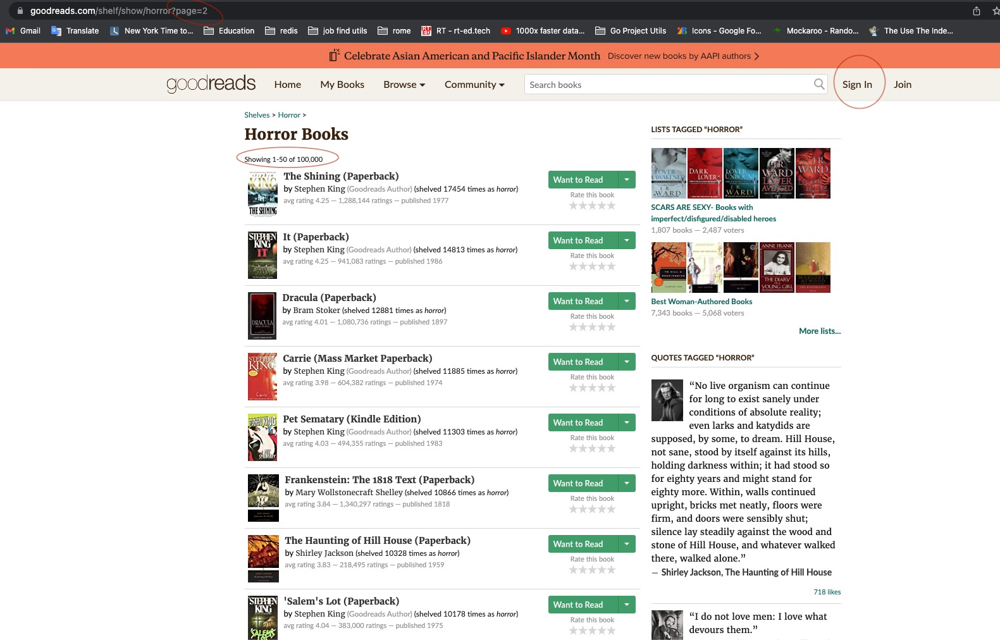

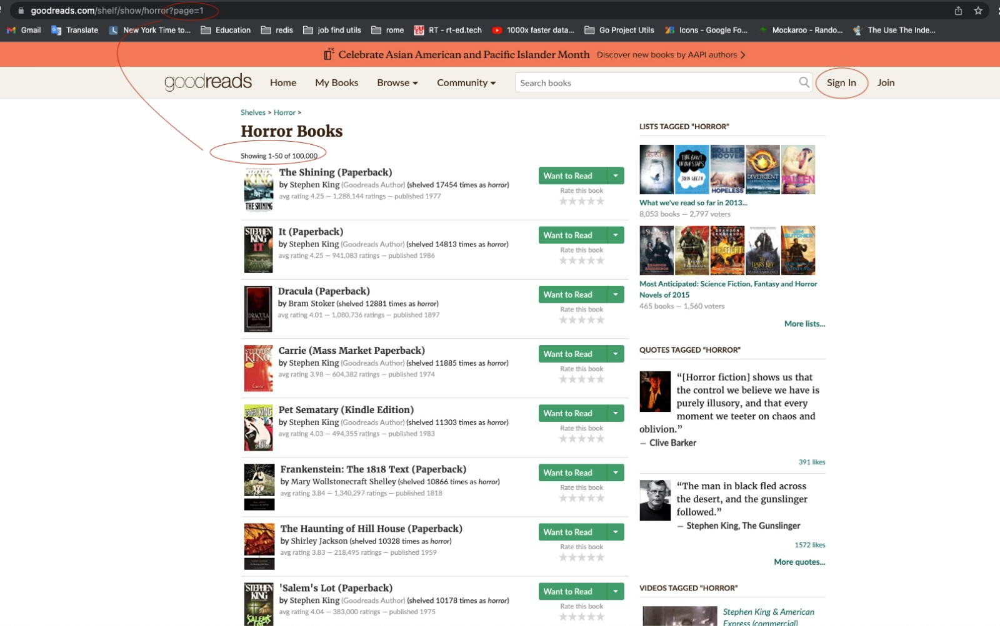

<a id='authentication_class'></a>
<h3>Authentication Class</h3>
<p>
Used to store authentication persistent data inside of a requests session, to allow private scraping
</p>

In [10]:
class SessionAuthenticator(ABC):
    @abstractmethod
    def authenticate(session: requests.Session):
        """gets requests session class and authenticate it to derived service"""

In [11]:
class GoodReadsAuthenticator(SessionAuthenticator):
    LOGIN_URL: str = "https://www.goodreads.com/user/sign_in"
    
    def __init__(self, user_email: str, user_password: str) -> None:
        if user_email is None:
            raise ValueError("invalid user_email")
        self.user_email = user_email
        if user_password is None:
            raise ValueError("invalid user_password")
        self.user_password = user_password
    
    def __get_authenticity_token(self, html: str) -> str:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        token_hidden_input: HtmlTag = soup.find("input", attrs={"name": "authenticity_token"})# hidden field
        if token_hidden_input is None:
            raise HtmlTagNotFoundException("authenticity_token_hidden_input is not found")
        return token_hidden_input.get("value").strip()

    def __get_n_value(self, html: str) -> str:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        n_hidden_input: HtmlTag = soup.find("input", attrs={"name": "n"})# used to be below "not a member?"
        if n_hidden_input is None:
            raise HtmlTagNotFoundException("n_hidden_input is not found")
        return n_hidden_input.get("value").strip()
    
    def authenticate(self, session: requests.Session):
        """gets requests.Session and provides cookie persistence for Good Reads"""
        
        login_form_page_res: requests.Response = get_request_with_retry(self.LOGIN_URL, session)

        authenticity_token: str = self.__get_authenticity_token(login_form_page_res.text)

        n_val: str = self.__get_n_value(login_form_page_res.text)
    
        login_payload: dict = {
            "user[email]": self.user_email,
            "user[password]": self.user_password,
            "authenticity_token": authenticity_token,
            "n": n_val
        }

        print(f"Attempting to log in to Good Reads...")
        
        authentication_res: requests.Response = session.post(self.LOGIN_URL, data=login_payload)
        if authentication_res.status_code != 200:
            raise AuthorizationFailureException("Good Reads login failure")
        print(f"logged in sucessfully...")


<h3>Authenticating...</h3>

In [12]:
session: requests.Session = requests.Session()
session.headers.update({"User-Agent": get_fake_user_agent()})# otherwise, default is: 'python-requests/2.26.0'
grAuth: SessionAuthenticator = GoodReadsAuthenticator(os.getenv("GOODREADS_EMAIL"), os.getenv("GOODREADS_PASSWORD"))

    grAuth.authenticate(session)

Attempting to log in to Good Reads...
logged in sucessfully...


<a id='scraping_process'></a>
<h3>Scraping Process</h3>
<p>
Once we finished with creating both the authentication class and the utilization functions we were right in the spot were we felt confident to start building a spider classes which will scrape the data for us automatically.
</p>
<p>
At first glance at the website we thought to ourselves, just how exactly we want to scrape the data?<br>
So went in to the website and started exploring the website in order to find the best route for our scraping proccess.
</p>
<p>
We could clearly see that our best option to get maximum data was in the book's page which contains huge amount of data.<br>
Right on first sight we could mark ourselves data which we knew we are going to use.<br>
The elements we saw right away:<br>
</p>

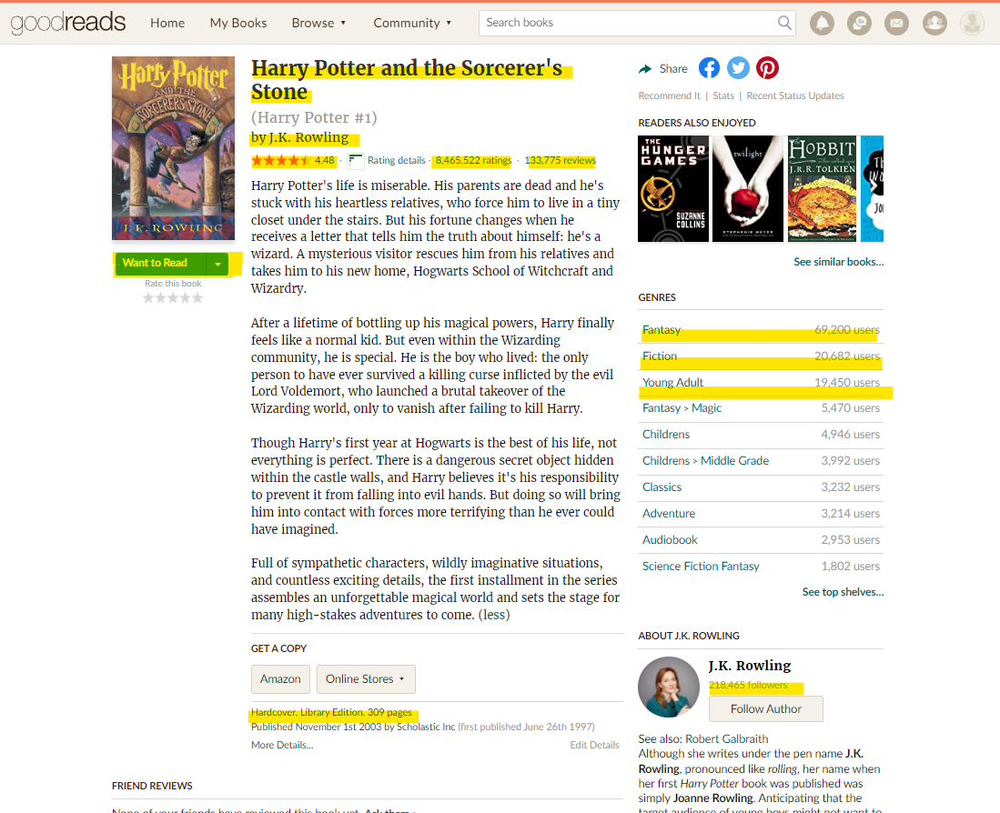

</p>
At this phase we asked ourselves 2 questions:<br>
<ol>
    <li>What is the exact data we wish to scrape?</li>
    <li>How can we easily access large amount of books which will present different types of books.</li>
</ol>
To move forward we first knew we need to know what exactly we want to scrape for each book.<br>
We could easily get from the book's page the following list:<br>
<ul>
    <li>title</li>
    <li>rating</li>
    <li>ratings count</li>
    <li>reviews count</li>
    <li>book format</li>
    <li>pages count</li>
    <li>main language</li>
    <li>editions count</li>
    <li>has awards - The most important field for us since we based our whole research on that page</li>
    <li>The top tagged genres for book - Which we decided 3 will be enough</li>
</ul>
But this was not enough information, we were not satisfied with that, so we continued to look for some more books and that's were we found some books had a field called "original name" - We had a feeling that this field my present a good change, where book did not succeed in onr name but did on another, therefore we added this field to the list.<br>
Yet we knew this was still not enough data, so we explored pages connected to the book's URL page to see what data is available from each book page.<br>
The first thing we wanted to have is connection to the author, we knew that book's success has to be somehow also related to the author that wrote the book.<br>
Luckily for us - The name of the author was also link to the author's page.
</p>

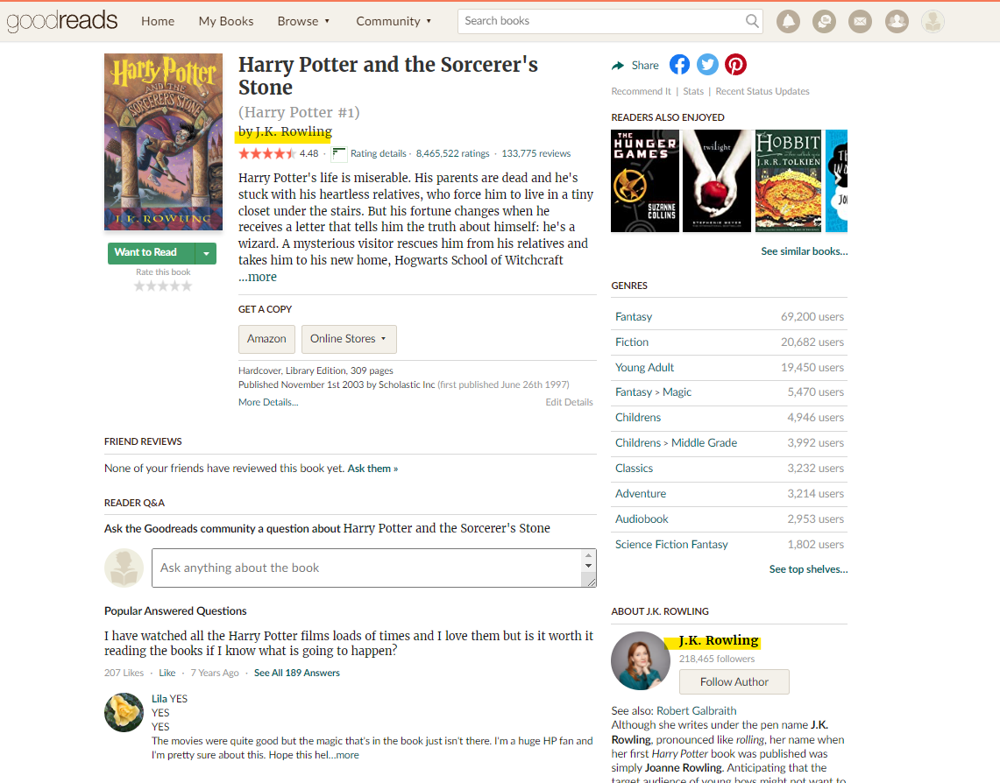

<p>
The exploration in the author's page then began.<br>
While we ere exploring the author's page we found the following data which we decided can be helpful for us in order to create a good prediction method.
<ul>
    <li>author name</li>
    <li>author followers count</li>
    <li>author books count</li>
    <li>author avg rating</li>
    <li>author ratings count</li>
    <li>author reviews count</li>
</ul>
</p>

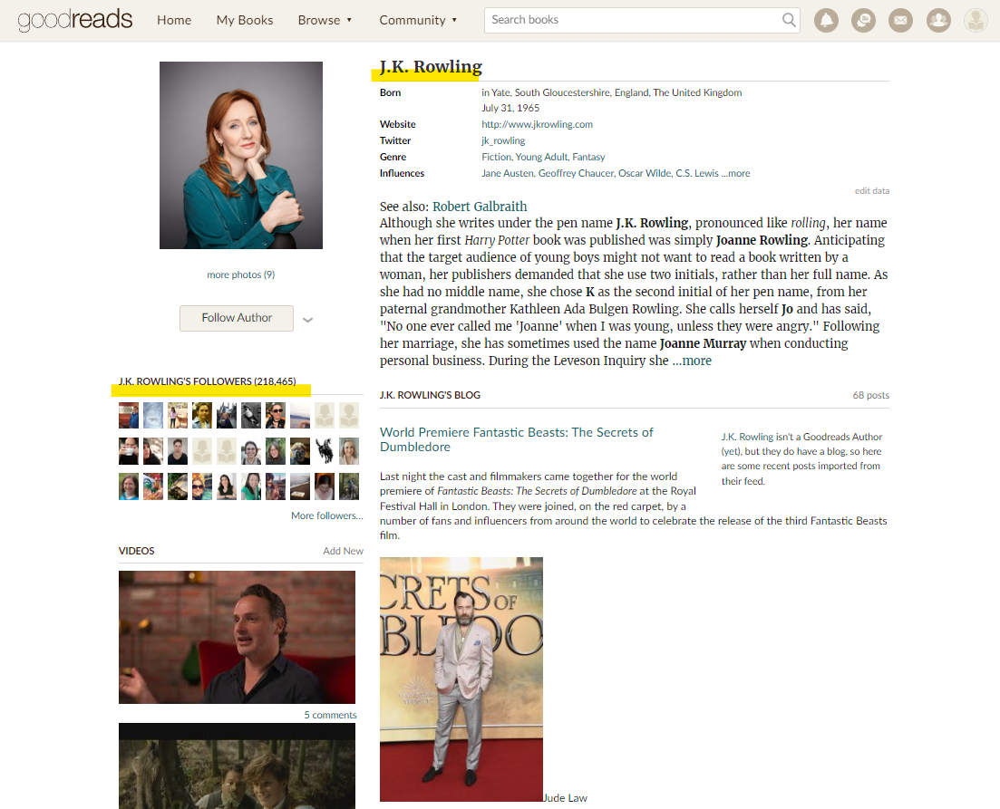

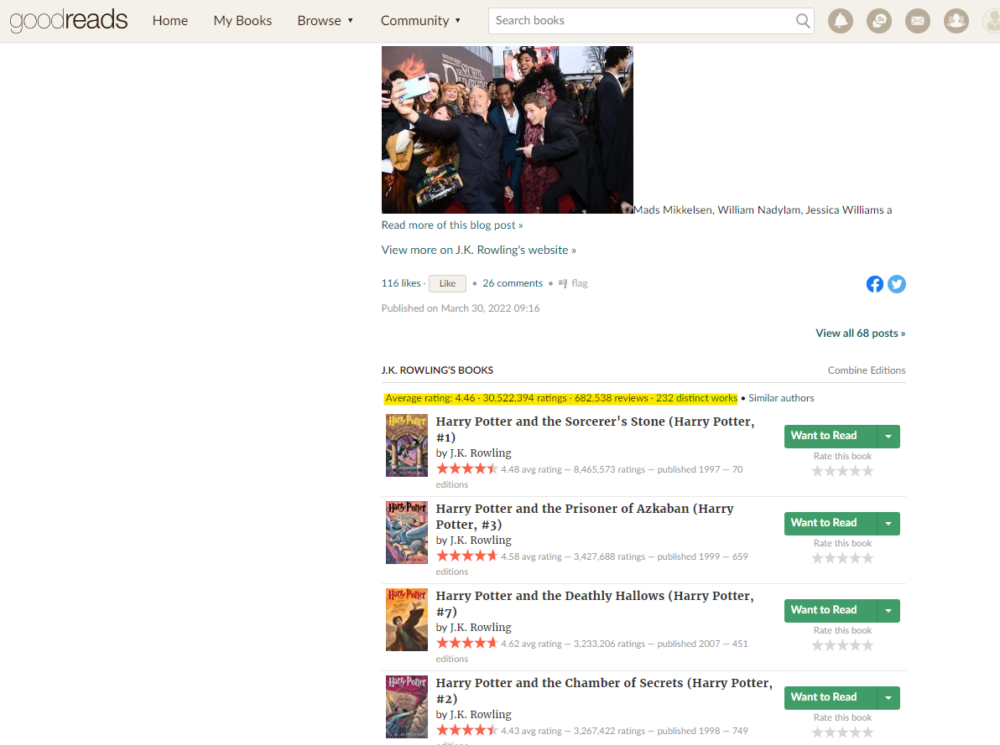

<p>
Now felt more confident about the data we have, but then we recalled one field that caught our interest in book page, which it was the "Want to Read" button at the book's page.<br>
We wandered, is there any way we could get the amount of people interested in reading the book?<br>
Back in the book's page we pressed the "Want to Read" button, that revealed a new field of interest to us - "Currently reading".
</p>

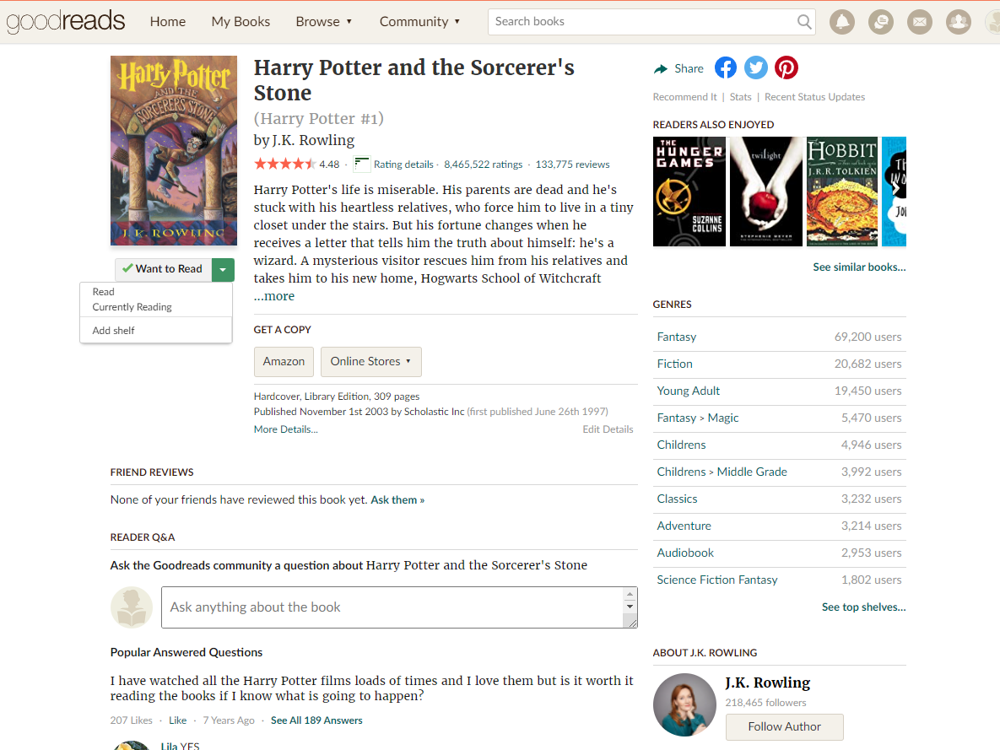

<p>
But still, we did not knew how to get to the number of how many users want to read the book or currently reading the book.<br>
So we kept exploring the book's page up to the point where we pressed the "see top shelves..." hyperlink, there we could finally get the numbers we wanted, Since both the "to read" and "currently reading" were actually tagged in the shelves.
</p>

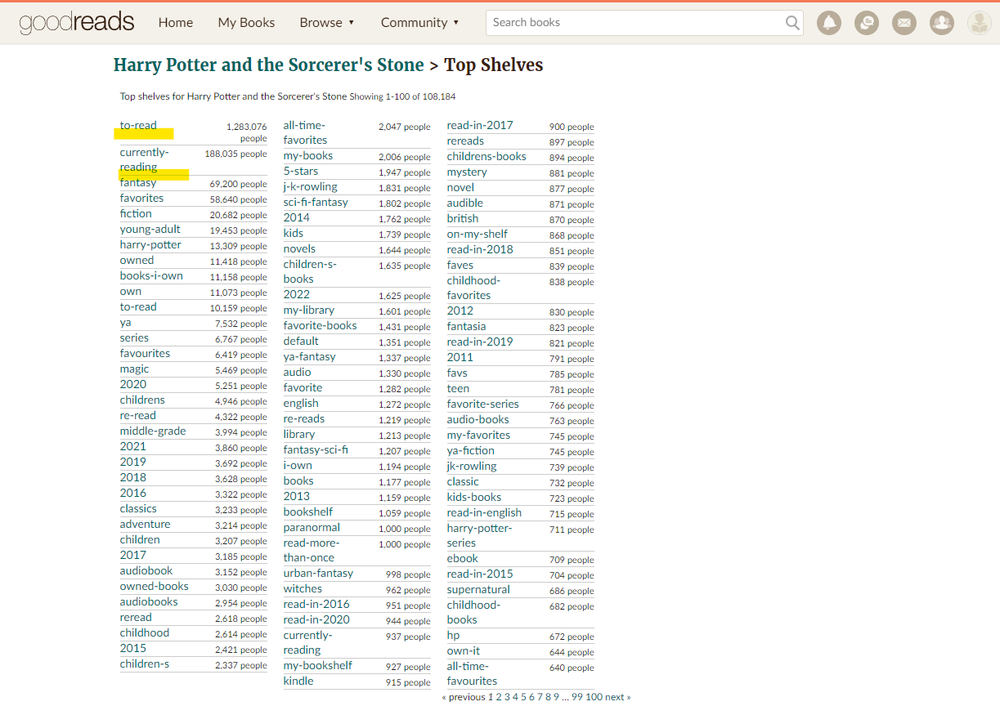

<h4>Great!</h4>
<p>
Now have all the data we want to scrape and we know the route from a book's page to the other pages which we can get the data from.<br>
That concludes both the first and the second questions we were asking ourselves.<br>
This is where we decided to create the first spider that scrape the data we agreed on.<br>
We inspected each and every elements we were looking for in the HTML tree of each page and the result led to this class:
</p>

<a id='book_spider_class'></id>
<h3>Book Spider Class</h3>
<p>
The book spider class is a tool which gets the book's url and the authentication session we are using and scrape the data from the book's page as well as from the author's page and the top shelves page (using another http request if needed for the other linked pages to the book's page).
</p>
Remider of the list of data and where are they scraped from:
<ul>
    <li>title - book page</li>
    <li>original title - book page</li>
    <li>rating - book page</li>
    <li>ratings count - book page</li>
    <li>reviews count - book page</li>
    <li>book format - book page</li>
    <li>pages count - book page</li>
    <li>main language - book page</li>
    <li>editions count - book page</li>
    <li>has awards - book page</li>
    <li>top tagged genre 1 - book page</li>
    <li>top tagged genre 2 - book page</li>
    <li>top tagged genre 3 - book page</li>
    <li>to read count - books top shelves</li>
    <li>currently reading count - books top shelves</li>
    <li>author name - author page</li>
    <li>author followers count - author page</li>
    <li>author books count - author page</li>
    <li>author avg rating - author page</li>
    <li>author ratings count - author page</li>
    <li>author reviews count - author page</li>
</ul>


In [13]:
class BookSpider(ABC):
    @abstractmethod
    def scrape_data(self):
        """scrapes book data and returns object or something"""

In [14]:
class GoodReadsBookSpider(BookSpider):
    def __init__(self, book_url: str, session: requests.Session) -> None:
        if book_url is None:
            raise ValueError("no book_url provided")
        self.book_url = book_url
        if session is None:
            raise ValueError("no session provided")
        self.session = session
    
    def __get_item_from_book_data_box(self, html: str, title: str) -> str:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        book_data_box: HtmlTag = soup.find("div", attrs={"id": "bookDataBox"})
        if book_data_box is None:
            return None
        for container in book_data_box.findAll("div", attrs={"class", "clearFloats"}):
            row_title = container.find("div", attrs={"class": "infoBoxRowTitle"})
            if row_title.get_text() == title:
                row_value = container.find("div", attrs={"class": "infoBoxRowItem"})
                return row_value.get_text().strip()
        return None
    
    def __get_title(self, html: str) -> str:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        book_title: HtmlTag = soup.find("h1", attrs={"id": "bookTitle"})
        if book_title is None:
            return None
        title = book_title.get_text().strip()
        if len(title) == 0:
            return None
        return title
    
    def __get_original_title(self, html: str) -> str:
        return self.__get_item_from_book_data_box(html, "Original Title")
        
    def __get_rating(self, html: str) -> float:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        rating_tag: HtmlTag = soup.find("span", attrs={"itemprop": "ratingValue"})
        if rating_tag is None:
            return np.nan
        return string_to_number(rating_tag.get_text().strip(), NumberTypesConverters.FLOAT.value)
        
    def __get_ratings_count(self, html: str) -> int:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        rating_tag: HtmlTag = soup.find("meta", attrs={"itemprop": "ratingCount"})
        if rating_tag is None:
            return np.nan
        rating_text = rating_tag.get_text().strip().split(" ")[0]
        return string_to_number(rating_text, NumberTypesConverters.INT.value)
        
    def __get_reviews_count(self, html: str) -> int:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        review_tag: HtmlTag = soup.find("meta", attrs={"itemprop": "reviewCount"})
        if review_tag is None:
            return np.nan
        review_text = review_tag.get_text().strip().split(" ")[0]
        return string_to_number(review_text, NumberTypesConverters.INT.value)
        
    def __get_book_format(self, html: str) -> str:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        book_format_tag: HtmlTag = soup.find("span", attrs={"itemprop": "bookFormat"})
        if book_format_tag is None:
            return None
        return book_format_tag.get_text().strip()
        
    def __get_pages_count(self, html: str) -> int:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        pages_num_tag: HtmlTag = soup.find("span", attrs={"itemprop": "numberOfPages"})
        if pages_num_tag is None:
            return np.nan
        pages_num_text = pages_num_tag.get_text().strip().split(" ")[0]
        return string_to_number(pages_num_text, NumberTypesConverters.INT.value)
        
    def __get_main_language(self, html: str) -> str:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        lang_tag: HtmlTag = soup.find("div", attrs={"itemprop": "inLanguage"})
        if lang_tag is None:
            return None
        lang = lang_tag.get_text().strip()
        if len(lang) == 0:
            return None
        return lang
        
    def __get_editions_count(self, html: str) -> int:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        editions_tag: HtmlTag = soup.find("div", attrs={"class": "otherEditionsLink"})
        if editions_tag is None:
            return 1
        editions_a = editions_tag.find("a")
        return string_to_number(extract_parentheses_value(editions_a.get_text().strip()), NumberTypesConverters.INT.value)
        
    def __get_has_awards(self, html: str) -> bool:
        return self.__get_item_from_book_data_box(html, "Literary Awards") is not None
        
    def __get_top_tagged_genre(self, html: str, place: int) -> str:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        generes_tags: HtmlTag = soup.findAll("a", attrs={"class": ["actionLinkLite", "bookPageGenreLink"]}, href=lambda value: value and value.startswith("/genres/"))
        if place > len(generes_tags):
            return None
        genre_tag = generes_tags[place - 1].get_text().strip()
        if len(genre_tag) == 0:
            return None
        return genre_tag
    
    # shelves
    
    def __get_shelf_stat(self, html: str, self_name: str) -> str:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        stats: HtmlTag = soup.findAll("div", attrs={"class": "shelfStat"})
        if stats is None:
            return None
        for stat in stats:
            stat_name = stat.find("a", attrs={"class": ["mediumText", "actionLinkLite"]})
            if stat_name.get_text() == self_name:
                stat_val = stat.find("div", attrs={"class": "smallText"})
                stat_val_text = stat_val.get_text().strip()
                if len(stat_val_text) == 0 or " " not in stat_val_text:
                    return None
                return stat_val_text.split(" ")[0]
        return None
    
    def __get_user_reading_shelves(self, html: str) -> dict:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        shelves_anchor: HtmlTag = soup.find("a", href=lambda value: value and value.startswith("/book/shelves/"))
        if shelves_anchor is None:
            return {"to_read_count": 0, "currently_reading_count": 0}
        shelves_url = f"https://www.goodreads.com/{shelves_anchor.get('href')}"
        shelves_response: requests.Response = get_request_with_retry(shelves_url, self.session)

        to_read_count = self.__get_to_read_count(shelves_response.text) 
        currently_reading_count = self.__get_currently_reading_count(shelves_response.text)
        
        return {"to_read_count": to_read_count, "currently_reading_count": currently_reading_count}

    def __get_to_read_count(self, html: str) -> int:
        read_count_str = self.__get_shelf_stat(html, "to-read")
        return string_to_number(read_count_str, NumberTypesConverters.INT.value)
        
    def __get_currently_reading_count(self, html: str) -> int:
        read_count_str = self.__get_shelf_stat(html, "currently-reading")
        return string_to_number(read_count_str, NumberTypesConverters.INT.value)
        
        
    # author
    
    def __get_author_info(self, html: str) -> dict:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        author_name_container: HtmlTag = soup.find("div", attrs={"class": "authorName__container"})
        author_name_url_tag = author_name_container.find("a", attrs={"class": "authorName", "itemprop": "url"})
        author_href = author_name_url_tag.get("href")
        author_response: requests.Response = get_request_with_retry(author_href, self.session)
        
        author_name = self.__get_author_name(author_response.text)
        author_followers_count = self.__get_author_followers_count(author_response.text)
        author_books_count = self.__get_author_books_count(author_response.text)
        author_avg_rating = self.__get_author_avg_rating(author_response.text)
        author_ratings_count = self.__get_author_author_ratings_count(author_response.text)
        author_reviews_count = self.__get_author_author_reviews_count(author_response.text)
        return {
            "author_name": author_name,
            "author_followers_count": author_followers_count,
            "author_books_count": author_books_count,
            "author_avg_rating": author_avg_rating,
            "author_ratings_count": author_ratings_count,
            "author_reviews_count": author_reviews_count
        }
    
    def __get_author_name(self, html: str) -> str:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        name_cont: HtmlTag = soup.find("h1", attrs={"class": "authorName"})
        if name_cont is None:
            return None
        name = name_cont.find("span", {"itemprop": "name"}).get_text().strip()
        if len(name) == 0:
            return None
        return name
        
    def __get_author_followers_count(self, html: str) -> int:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        author_followers_count_el: HtmlTag = soup.find("a", href=lambda value: value and value.startswith("/author_followings?"))
        if author_followers_count_el is None:
            return np.nan
        author_followers_count: int = string_to_number(extract_parentheses_value(author_followers_count_el.get_text().strip()), NumberTypesConverters.INT.value)
        return author_followers_count
        
    def __get_author_books_count(self, html: str) -> int:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        author_books_count_parent: HtmlTag = soup.find("div", attrs={"class": "hreview-aggregate", "itemprop": "aggregateRating"})
        if author_books_count_parent is None:
            return np.nan
        distinct_works_text_container: HtmlTag = author_books_count_parent.find("a", href=lambda value: value and value.startswith("/author/list/"))
        return string_to_number(distinct_works_text_container.get_text().split(" ")[0], NumberTypesConverters.INT.value)
        
    def __get_author_avg_rating(self, html: str) -> float:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        cont = soup.find("span", attrs={"class": "average", "itemprop": "ratingValue"})
        if cont is None or len(cont.get_text().strip()) == 0:
            return np.nan
        author_average_rating: float = string_to_number(cont.get_text().strip(), NumberTypesConverters.FLOAT.value)
        return author_average_rating
        
    def __get_author_author_ratings_count(self, html: str) -> int:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        cont = soup.find("span", attrs={"itemprop": "ratingCount"})
        if cont is None:
            return np.nan
        author_ratings_count: int = string_to_number(cont.get("content"), NumberTypesConverters.INT.value)
        return author_ratings_count
        
    def __get_author_author_reviews_count(self, html: str) -> int:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        cont = soup.find("span", attrs={"itemprop": "reviewCount"})
        if cont is None:
            return np.nan
        author_reviews_count: int = string_to_number(cont.get("content"), NumberTypesConverters.INT.value)
        return author_reviews_count
        
    def scrape_data(self):
        book_page_response: requests.Response = get_request_with_retry(self.book_url, self.session)
        title = self.__get_title(book_page_response.text)
        original_title = self.__get_original_title(book_page_response.text)
        rating = self.__get_rating(book_page_response.text) 
        ratings_count = self.__get_ratings_count(book_page_response.text)
        reviews_count = self.__get_reviews_count(book_page_response.text)     
        book_format = self.__get_book_format(book_page_response.text)
        pages_count = self.__get_pages_count(book_page_response.text) 
        main_language = self.__get_main_language(book_page_response.text)
        editions_count = self.__get_editions_count(book_page_response.text) 
        has_awards = self.__get_has_awards(book_page_response.text)
        top_tagged_genre_1 = self.__get_top_tagged_genre(book_page_response.text, 1)
        top_tagged_genre_2 = self.__get_top_tagged_genre(book_page_response.text, 2)
        top_tagged_genre_3 = self.__get_top_tagged_genre(book_page_response.text, 3)     
        
        user_reading_shelves = self.__get_user_reading_shelves(book_page_response.text)
        author_info = self.__get_author_info(book_page_response.text)   
        
        return {
            "title": title,
            "original_title": original_title,
            "rating": rating,
            "ratings_count": ratings_count,
            "reviews_count": reviews_count,
            "book_format": book_format,
            "pages_count": pages_count,
            "main_language": main_language,
            "editions_count": editions_count,
            "has_awards": has_awards,
            "top_tagged_genre_1": top_tagged_genre_1,
            "top_tagged_genre_2": top_tagged_genre_2,
            "top_tagged_genre_3": top_tagged_genre_3,
            "to_read_count": user_reading_shelves["to_read_count"],
            "currently_reading_count": user_reading_shelves["currently_reading_count"],
            "author_name": author_info["author_name"],
            "author_followers_count": author_info["author_followers_count"],
            "author_books_count": author_info["author_books_count"],
            "author_avg_rating": author_info["author_avg_rating"],
            "author_ratings_count": author_info["author_ratings_count"],
            "author_reviews_count": author_info["author_reviews_count"]
        }


<a id='scraping_route_creation'></a>
<h3>Creating the route for successful scraping</h3>
<p>
Now what left was just to find the way to access a large amount of different types of books.<br>
So we went on and thought about what could be the best way to get different types of books? Genres of course!<br>
Great, We know how to get a great scale of books, So we decided to check how does the genres page looks like when exploring all the genres.
</p>

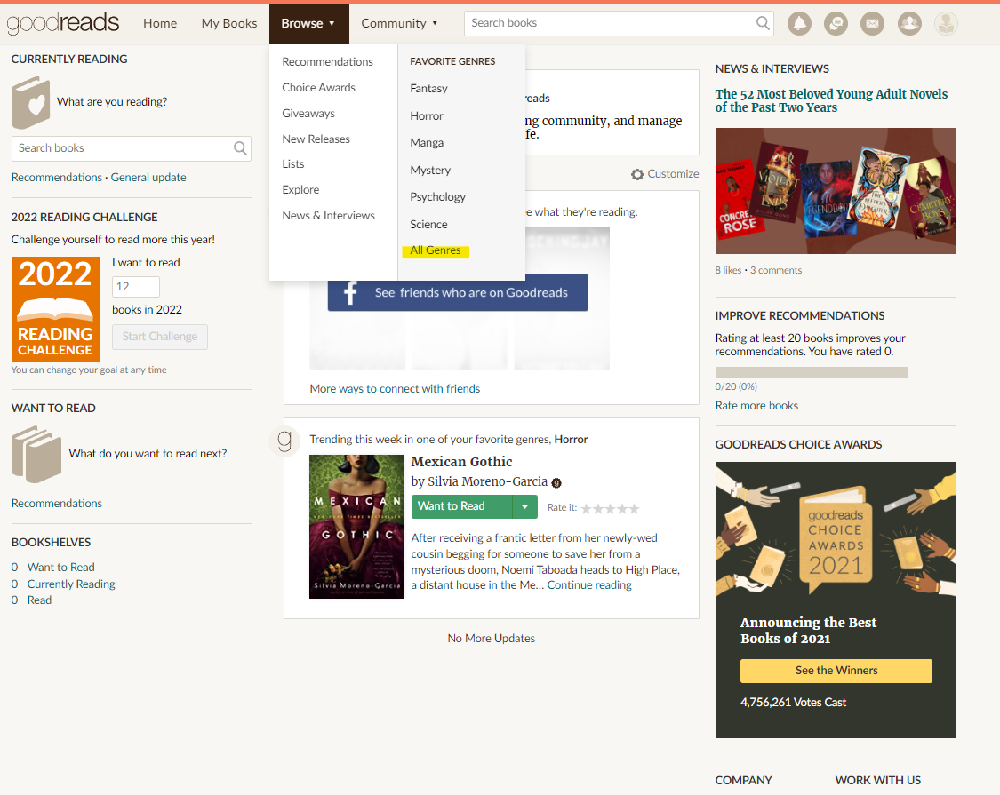

<p>
This is the page we found out there.
</p>

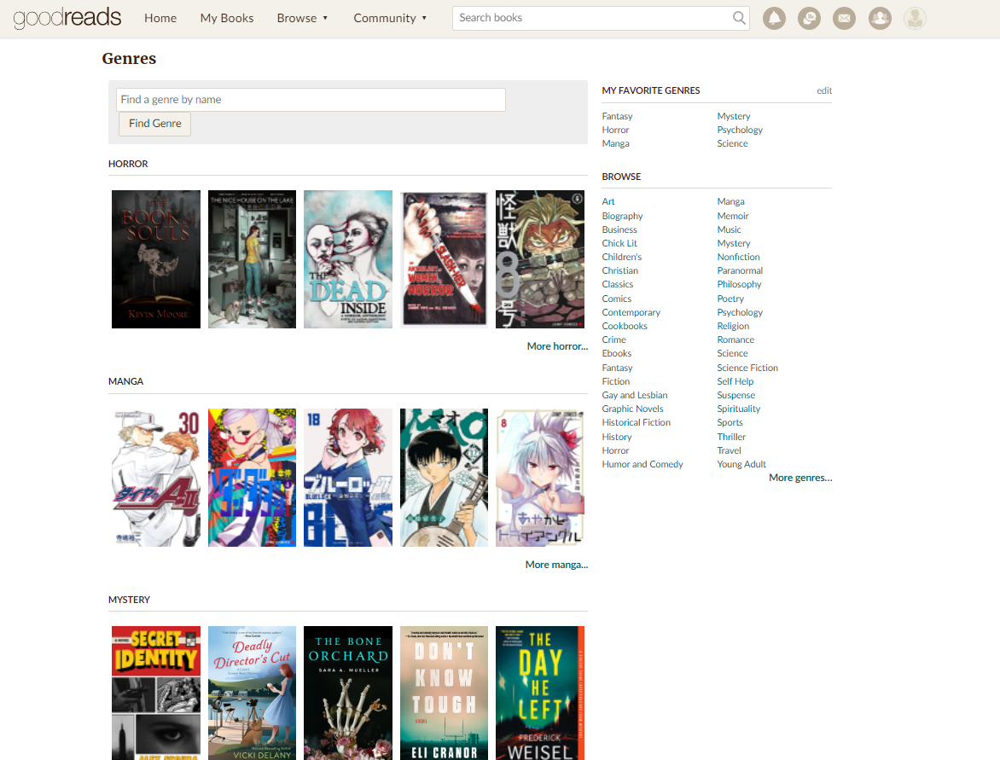

<p>
Inside a genre we could see the access to book links but we were not satisfied with the way we can access book link from the generes page - The coverWrapper class was too generic and we had no access to large amount of books.
</p>

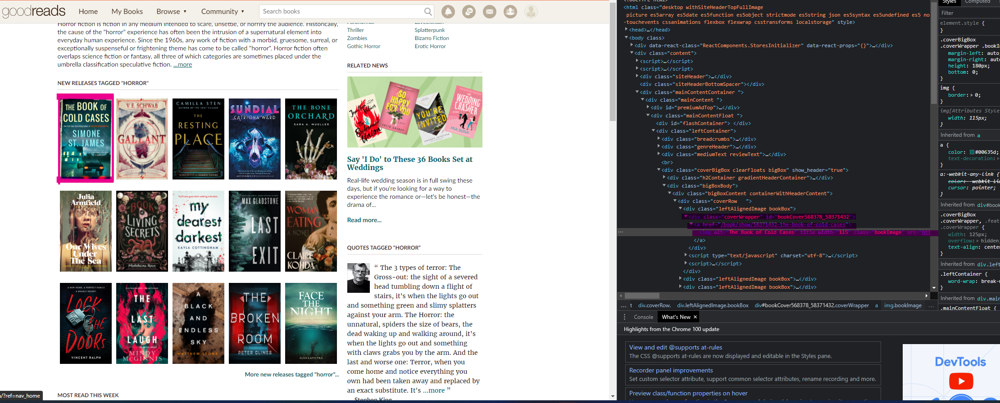

<p>
Exploration of the genere page led to this button:
</p>

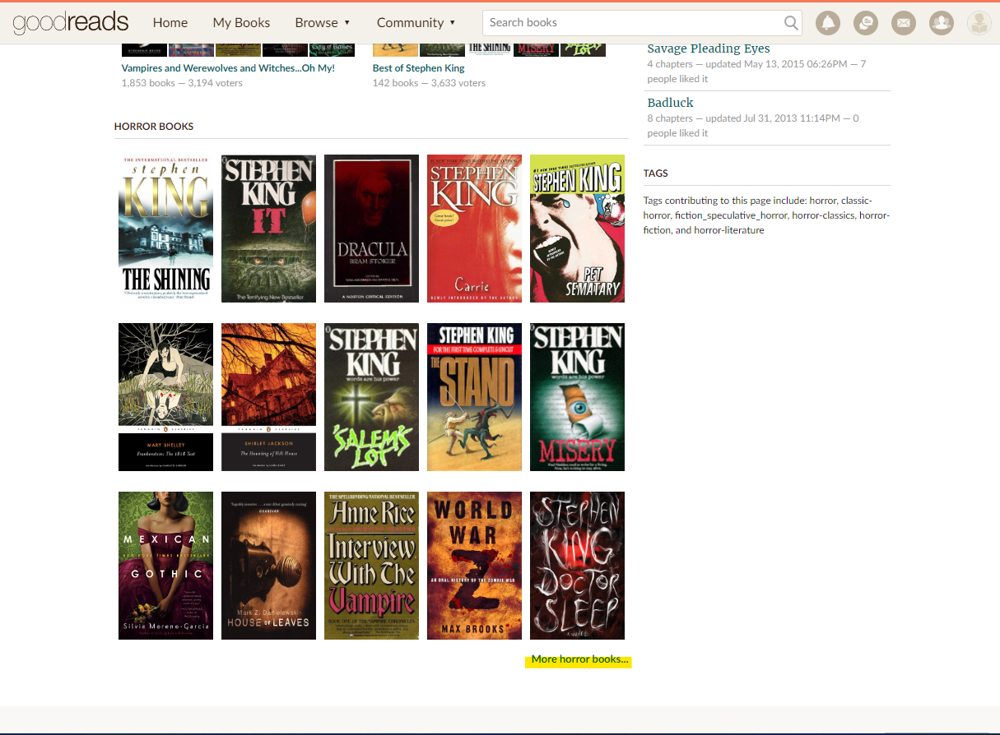

<p>
Which this link provided us with the solution to all of our problems.<br>
This page's URL built from easy to explore api links:<br>
<ul>
    <li><a href="https://www.goodreads.com/shelf/show" target="_blank">https://www.goodreads.com/shelf/show</a></li>
    <li>followed by the genre</li>
    <li>with ending of which page are you at</li>
</ul>
Example for a complete URL - <a href=https://www.goodreads.com/shelf/show/horror?page=2 target="_blank">https://www.goodreads.com/shelf/show/horror?page=2</a><br>
Moreover, accessing a book's page was easy from this page.
Last but not least we knew exactly how many books to expect each page since each shelf page holds up to 50 books per page.

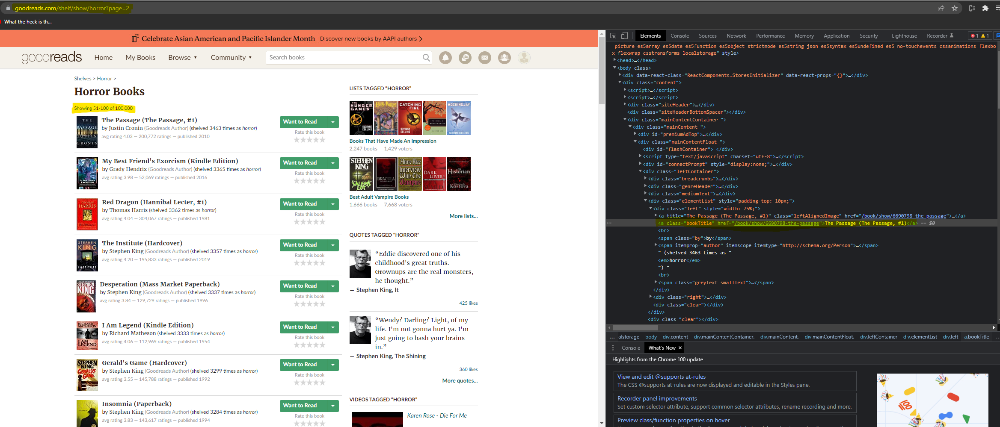

<a id='genre_spider'></a>
<h3>Genre Spider Class</h3>
<p>
Once we found out the right way to start scraping the data, now what's left is to create a genre spider which will handle browsing inside genres and help us getting the books easily.<br>
We built a Genre spider which gets a genre from a list of genres we decided, the spider handles the mechanism for fetching pages by genre and using books scrapers to store books data.
</p>

In [15]:
class GenreSpider(ABC):
    @abstractmethod
    def scrape_books(self, max_books: int, books_offset: int) -> pd.DataFrame:
        """scrapes genre books data and returns dataframe"""

In [16]:
class GoodReadsGenreSpider(GenreSpider):
    GENRE_EXPLORATION_URL = f"https://www.goodreads.com/shelf/show"
    PAGE_BOOKS_NUM = 50
    GOOD_READS_DEFINED_GENRE_MAX = 100_000
    
    def __init__(self, genre_name: str, session: requests.Session) -> None:
        if genre_name is None:
            raise ValueError("no genre_name provided")
        self.genre_name = genre_name
        if session is None:
            raise ValueError("no session provided")
        self.session = session
    
    def __get_page_books(self, html: str) -> List[dict]:
        soup: BeautifulSoup = BeautifulSoup(html, "html.parser")
        books_url_tags = soup.find_all("a", {"class": "bookTitle"})
        books = []
        for book_url_tag_tag in books_url_tags:
            book_url = f"https://www.goodreads.com{book_url_tag_tag.get('href')}"
            bs: BookSpider = GoodReadsBookSpider(book_url, self.session)
            book = bs.scrape_data()
            books.append(book)
            print(f"genre={self.genre_name}, new book has been fetched sucessfully, page scope: {len(books)}/{len(books_url_tags)}")
        return books
        
    def scrape_books(
        self,
        max_books: int = None,
        books_offset: int = 0
    ) -> pd.DataFrame:
        genre_url = f"{self.GENRE_EXPLORATION_URL}/{self.genre_name}"
        if max_books is None:
            max_books = self.GOOD_READS_DEFINED_GENRE_MAX
        
        has_next = True
        
        page = 1
        if books_offset > self.PAGE_BOOKS_NUM:
            page += int(books_offset / self.PAGE_BOOKS_NUM)
        
        books = []
        while len(books) < max_books and has_next:
            page_url = f"{genre_url}?page={page}"
            print(f"fetching genre={self.genre_name}, page={page}")
            page += 1
            page_response: requests.Response = get_request_with_retry(page_url, self.session)
            if page_response.status_code == 404:
                has_next = False
                continue
            page_books = self.__get_page_books(page_response.text)
            if len(page_books) < self.PAGE_BOOKS_NUM:
                has_next = False
            books.extend(page_books)

            
                
        return pd.DataFrame.from_records(books)

<a id='scraping'></a>
<h2>Scraping - Let's start scraping</h2>
<p>
    But before we started scraping there was something we wanted to improve in our scraping model.<br>
    Because scraping is a lot of IO and different genres are not dependent, in order to have better network utilization we have decided to use multi-threading.<br>
    We did not want to overload the site and harm other users experience with over-requesting, however we wanted to decrease our scraping time by scraping multiple genres at the same time.<br>
    But what is the right number of threads that will remain balance between faster scraping and not causing over-requesting from the website which will also delay the server's response time?<br>
    The best practice was by doing "trial and error" here are the trials we did:<br>
    <ul>
        <li>2 Threads simultaneously - did not improve the scraping time to our satisfaction.</li>
        <li>All Threads simultaneously (17 threads) - The server was overloaded and we did not get responses in a decent time.</li>
        <li>10 Threads simultaneously - As we suspected it was still too much for the server to handle.</li>
        <li>5 Threads simultaneously - The server response time was as fast as send single threaded request.</li>
    </ul>
    In conclusion we ran 5 threads which were scraping 5 different genres at the same time.
</p>    


In [16]:
import threading

def explore_genre(genre: str):
    print(f"start working on genre: {genre}")
    gs: GenreSpider = GoodReadsGenreSpider(genre, session)
    genre_df = gs.scrape_books(max_books=1000)
    file_name = f"{genre}_books"
    genre_df.to_parquet(f"./books_by_genres/{file_name}")
    print(f"work on genre: {genre} has been finished")

target_genres_to_explore = [
    "fantasy",
    "crime",
    "fiction",
    "horror",
    "manga",
    "psychology",
    "travel",
    "thriller",
    "adult",
    "sport",
    "science",
    "science-fiction",
    "biography",
    "self-help",
    "religion",
    "history",
    "cookbooks"
]

MAX_CONCURRENTLY = 5

genres_buckets = []
offset = 0
while offset < len(target_genres_to_explore):
    genres_buckets.append(target_genres_to_explore[offset:MAX_CONCURRENTLY + offset])
    offset += MAX_CONCURRENTLY

for genres in genres_buckets:
    print(f"start genre bucket: {genres}")
    threads = []

    for genre in genres:
        threads.append(threading.Thread(target=explore_genre, args=(genre,)))

    for thread in threads:
        thread.start()

    for thread in threads:
        thread.join()
    print(f"end genre bucket: {genres}")

print("done all target genres exploration")

note: accidently restarted output, won't run this long scraping stage again


<a id='first_crawl'></a>
<h3>First Crawl Conclusion</h3>
<p>
As can be seen, in the logs above, although at the start, we have set boundary of 1000 books at max for each genre, it seems like some of the genres are having just 6 pages and such.<br>
You can see it below, as the travel books rows count is below 1000 (below 20 pages)
</p>

In [17]:
example_genre_with_low_books_number_df = pd.read_parquet(f"./books_by_genres/travel_books")
example_genre_with_low_books_number_df.shape

(299, 21)

<h3>First Crawl Conclusion - Continue</h3>
<p>
In addition, after further investigating our scrape target website, we see that all genres have up to 25 pages (1250 books) to browse (AT MAX).
Therefore, We are going to run the scrape flow again so we fetch every book we are able to (by selected genres), but this time change the genreSpider class to support offset, so it won't re-read the same books again, AND we will append the books this time to the existing parquet file, instead of overwriting them... other than that, same approach.
NOTE: original Class as been updated.
</p>

<ul>
    <li>
        Same Target Genres, <strong>Altough, only the ones which have any books left to scrape. (the genres which has 1000 books in their df (prev max)</strong>
    </li>
    <li>
        same multi-threades approach
    </li>
</ul>

In [1]:
# getting only relevant genres (to better perform I/O utilization) 
# (prevent case of just 2 genres in same threading group with idles genres - waste of time)
new_target_genres_to_explore = []

for genre in target_genres_to_explore:
    file_name = f"{genre}_books"
    file_path = f"./books_by_genres/{file_name}"
    prev_max = 1000
    df = pd.read_parquet(file_path)
    if df.shape[0] == prev_max:
        new_target_genres_to_explore.append(genre)

# again, bucket the genres up..        
MAX_CONCURRENTLY = 5 # same as before

genres_buckets = []
offset = 0
while offset < len(new_target_genres_to_explore):
    genres_buckets.append(target_genres_to_explore[offset:MAX_CONCURRENTLY + offset])
    offset += MAX_CONCURRENTLY

# just passing offset to scraper instead of max...
def explore_genre(genre: str):
    print(f"start working on genre: {genre}")
    gs: GenreSpider = GoodReadsGenreSpider(genre, session)
    genre_df = gs.scrape_books(books_offset=1000)
    if genre_df.shape[0] == 0:
        return # already fetched all this genre books, empty df.
    file_name = f"{genre}_books"
    file_path = f"./books_by_genres/{file_name}"
    # reading df and concat instead of overwrting prev one...
    prev_genre_df = pd.read_parquet(file_path)
    genre_books = pd.concat([prev_genre_df, genre_df])
    genre_books.to_parquet(file_path)
    print(f"work on genre: {genre} has been finished")

for genres in genres_buckets:
    print(f"start genre bucket: {genres}")
    threads = []

    for genre in genres:
        threads.append(threading.Thread(target=explore_genre, args=(genre,)))

    for thread in threads:
        thread.start()

    for thread in threads:
        thread.join()
    print(f"end genre bucket: {genres}")

print("done all target genres exploration")

logs were removed due to a lot of data size which harm file size


<a id='concating_data'></a>
<h3>Now, let's concat all those genres dataframes into one single books dataframe</h3>

In [21]:
books_by_genre_dfs = []

for genre in target_genres_to_explore:
    file_name = f"{genre}_books"
    file_path = f"./books_by_genres/{file_name}"
    genre_df = pd.read_parquet(file_path)
    books_by_genre_dfs.append(genre_df)

pd.concat(books_by_genre_dfs).to_parquet("./books.parquet")

<a id='data_scraped'></a>
<h3>Let's check how much data did we scrape before we start cleaning it (if needed)</h3>

In [48]:
books_df = pd.read_parquet("./books.parquet")
print(f"df shape:{books_df.shape}")
print(f"data amount before cleaning: {'{:,}'.format(books_df.shape[0] * books_df.shape[1])} (rows * cols)")
books_df.head(10)

df shape:(17787, 21)
data amount before cleaning: 373,527 (rows * cols)


,title,original_title,rating,ratings_count,reviews_count,book_format,pages_count,main_language,editions_count,has_awards,...,top_tagged_genre_2,top_tagged_genre_3,to_read_count,currently_reading_count,author_name,author_followers_count,author_books_count,author_avg_rating,author_ratings_count,author_reviews_count
0,Harry Potter and the Sorcerer's Stone,Harry Potter and the Philosopher's Stone,4.48,8441371,133336,Hardcover,309.0,English,943,True,...,Fiction,Young Adult,1283076,188035,J.K. Rowling,218277,221,4.46,30437859,680605
1,Harry Potter and the Chamber of Secrets,Harry Potter and the Chamber of Secrets,4.43,3257357,64091,Hardcover,341.0,English,747,True,...,Fiction,Young Adult,348492,80951,J.K. Rowling,218277,221,4.46,30437859,680605
2,Harry Potter and the Prisoner of Azkaban,Harry Potter and the Prisoner of Azkaban,4.58,3415829,67390,Mass Market Paperback,435.0,English,658,True,...,Young Adult,Fiction,366354,58830,J.K. Rowling,218277,221,4.46,30437859,680605
3,"The Hobbit, or There and Back Again","The Hobbit, or There and Back Again",4.28,3344315,56741,Paperback,366.0,English,50,True,...,Classics,Fiction,890447,74818,J.R.R. Tolkien,63711,396,4.35,9626760,160876
4,Harry Potter and the Goblet of Fire,Harry Potter and the Goblet of Fire,4.57,3041195,55963,Paperback,734.0,English,608,True,...,Young Adult,Fiction,360512,71532,J.K. Rowling,218277,221,4.46,30437859,680605
5,Harry Potter and the Order of the Phoenix,Harry Potter and the Order of the Phoenix,4.50,2912381,51209,Paperback,870.0,English,140,True,...,Young Adult,Fiction,407926,62657,J.K. Rowling,218277,221,4.46,30437859,680605
6,Harry Potter and the Half-Blood Prince,Harry Potter and the Half-Blood Prince,4.57,2820532,47036,Paperback,652.0,English,483,True,...,Young Adult,Fiction,416502,38601,J.K. Rowling,218277,221,4.46,30437859,680605
7,A Game of Thrones,A Game of Thrones,4.44,2221292,57478,Mass Market Paperback,835.0,English,424,True,...,Fiction,Fantasy,888837,103295,George R.R. Martin,100888,676,4.37,6196387,211312
8,The Fellowship of the Ring,The Lord of the Rings: The Fellowship of the Ring,4.38,2563013,28979,Mass Market Paperback,527.0,English,729,True,...,Classics,Fiction,662233,58356,J.R.R. Tolkien,63711,396,4.35,9626760,160876
9,A Clash of Kings,A Clash of Kings,4.41,848546,25166,Paperback,969.0,English,302,True,...,Fiction,Fantasy,219395,38197,George R.R. Martin,100888,676,4.37,6196397,211312


<h3>Great!</h3>
<p>
    We finally scraped the data we were looking for we are now ready for the next step.
</p>

<a id='data_cleaning'></a>
<h2>Data Cleaning</h2>
<p>
    After the scraping process we could easily tell that some data is duplicated.<br>
    First, Let's clean these duplicate books.
</p>

In [49]:
books_no_dup = books_df[~books_df.duplicated()]
books_no_dup.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 17228 entries, 0 to 999
Data columns (total 21 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   title                    17228 non-null  object 
 1   original_title           15346 non-null  object 
 2   rating                   17228 non-null  float64
 3   ratings_count            17228 non-null  int64  
 4   reviews_count            17228 non-null  int64  
 5   book_format              17168 non-null  object 
 6   pages_count              17127 non-null  float64
 7   main_language            16355 non-null  object 
 8   editions_count           17228 non-null  int64  
 9   has_awards               17228 non-null  bool   
 10  top_tagged_genre_1       17228 non-null  object 
 11  top_tagged_genre_2       17226 non-null  object 
 12  top_tagged_genre_3       17224 non-null  object 
 13  to_read_count            17228 non-null  int64  
 14  currently_reading_count 

<p>
    As can be seen we got rid of 559 rows of duplicated books just by using a built in pandas function called <strong>duplicated</strong>.<br>
    For more information see documentation: 
    <a href="https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.duplicated.html">Here</a>
</p>

<a id='corrupted_data_cleaning'></a>
<h3>Clean Corrupted Data</h3>
<p>
    Now that we know duplicates are gone, let's take a look at our DataFrame and see what defects in the data do we have.
</p>    

In [50]:
books_no_dup.describe()

,rating,ratings_count,reviews_count,pages_count,editions_count,to_read_count,currently_reading_count,author_followers_count,author_books_count,author_avg_rating,author_ratings_count,author_reviews_count
count,17228.000000,1.722800e+04,17228.000000,17127.000000,17228.000000,1.722800e+04,17228.000000,17228.000000,17228.000000,17228.000000,1.722800e+04,17228.000000
mean,4.047600,1.106271e+05,5728.685338,358.469960,132.433016,6.842973e+04,4469.086197,24300.382633,596.166705,4.048028,9.416101e+05,46307.252612
std,0.249037,3.450998e+05,12772.222938,215.448426,623.350665,1.479739e+05,10662.045246,94132.881836,8738.137547,0.206713,2.487531e+06,104226.208437
min,2.420000,5.700000e+01,2.000000,0.000000,1.000000,0.000000e+00,0.000000,0.000000,1.000000,3.070000,8.300000e+01,4.000000
25%,3.890000,4.509750e+03,320.000000,245.000000,12.000000,4.646500e+03,277.000000,397.000000,17.000000,3.930000,2.523675e+04,2052.000000
50%,4.060000,1.777550e+04,1230.000000,326.000000,30.000000,1.538600e+04,1053.000000,2247.000000,47.000000,4.050000,1.502305e+05,10727.500000
75%,4.210000,7.563200e+04,5038.000000,419.000000,72.000000,6.373075e+04,3786.000000,11229.000000,143.000000,4.180000,6.690410e+05,39963.500000
max,4.850000,8.441371e+06,183745.000000,14777.000000,13140.000000,1.907997e+06,188035.000000,790691.000000,192863.000000,4.730000,3.044132e+07,712349.000000


<p>
    As can be seen, author_books_count max: 192,863 is too high, let's check what's the cause.<br>
    Approaching to this issue done by looking who is exactly this author with a huge amount of books.
</p>

In [51]:
max_author_books_count = books_no_dup['author_books_count'].max()
books_no_dup[books_no_dup['author_books_count'] == max_author_books_count]\
.groupby(by="author_name").apply(lambda x: x).iloc[0]['author_name']

'Anonymous'

<p>
    Result was <strong>Anonymous</strong>, Pretty suspicious but we still didn't want to remove books which have no known author before we know how much will it affect our statistics.<br>
    let's look at the data of the books marked with the Anonymous author.
</p>

In [52]:
books_no_dup[books_no_dup['author_books_count'] == books_no_dup['author_books_count'].max()].groupby(by="author_name").apply(lambda x: x).iloc[0]

title                      The Holy Bible: English Standard Version
original_title                                                 None
rating                                                         4.54
ratings_count                                                 42733
reviews_count                                                  1685
book_format                                          Kindle Edition
pages_count                                                  1243.0
main_language                                               English
editions_count                                                  873
has_awards                                                    False
top_tagged_genre_1                                        Christian
top_tagged_genre_2                                         Religion
top_tagged_genre_3                                       Nonfiction
to_read_count                                                 16590
currently_reading_count                         

<p>
    As can be seen, there are a lot of coloums with suspicious values which may harm our outlier detection,<br>
    i.e: the median for author_books_count actually should be very low in compared to that.
</p>

In [53]:
books_no_dup['author_books_count'].median()

47.0

<p>
    We were curious to see how many books out of the 17,228 books we have right now actually marked as Anonymous author.<br>
    Let's count how many books we have which are marked as Anonymous author.
</p>

In [54]:
books_no_dup[books_no_dup['author_name'] == "Anonymous"].shape

(33, 21)

<p>
    Not many books, 33 books out of 17,728 are not 1% out of the amount of books we own.<br>
    Let's remove them.
</p>    

In [55]:
books_no_dup = books_no_dup[books_no_dup['author_name'] != "Anonymous"]

books_no_dup[books_no_dup['author_name'] == "Anonymous"].shape

(0, 21)

<p>
    Good, No more Anonymous authors, Let's re-check our DataFrame info again.
</p>    

In [56]:
books_no_dup[books_no_dup['author_books_count'] == books_no_dup['author_books_count'].max()].groupby(by="author_name").apply(lambda x: x).iloc[0]

title                        Beowulf
original_title               Beowulf
rating                          3.46
ratings_count                 270311
reviews_count                   7784
book_format                Paperback
pages_count                    245.0
main_language                English
editions_count                  1269
has_awards                     False
top_tagged_genre_1          Classics
top_tagged_genre_2            Poetry
top_tagged_genre_3           Fiction
to_read_count                 114328
currently_reading_count         4662
author_name                  Unknown
author_followers_count          1409
author_books_count            162128
author_avg_rating               3.57
author_ratings_count          489820
author_reviews_count           22348
Name: 91, dtype: object

<p>
    Again we found out the top number of books count is too high and stands at: 162,128.<br>
    That led us to do the same flow we did with Anonymous author but this time with <strong>Unknown</strong>
    author.
</p>    

In [57]:
books_no_dup[books_no_dup['author_name'] == "Unknown"].shape

(4, 21)

<p>
    Even less than previous cycle, 4 books total.<br>
    Let's remove them.
</p>    

In [58]:
books_no_dup = books_no_dup[books_no_dup['author_name'] != "Unknown"]

books_no_dup[books_no_dup['author_name'] == "Unknown"].shape

(0, 21)

<p>
    Let's take a another look at the info of the books count.
</p>

In [59]:
books_no_dup[books_no_dup['author_books_count'] == books_no_dup['author_books_count'].max()].groupby(by="author_name").apply(lambda x: x).iloc[0]

title                                The Tempest
original_title                              None
rating                                       3.8
ratings_count                             189407
reviews_count                               5067
book_format                Mass Market Paperback
pages_count                                218.0
main_language                            English
editions_count                              3433
has_awards                                 False
top_tagged_genre_1                      Classics
top_tagged_genre_2                         Plays
top_tagged_genre_3                         Drama
to_read_count                                653
currently_reading_count                     2789
author_name                  William Shakespeare
author_followers_count                     39153
author_books_count                          7041
author_avg_rating                           3.87
author_ratings_count                     7025736
author_reviews_count

<h3>Success</h3>
<p>
    We finally got to the point where the number of books related to the author is reasonable and moreover the author is one of the 
    most popular authors ever lived (William Shakespeare).<br>
    <strong>Note: We did notice the enormous amount of editions count for our new top books count author, but it is a legit outlier</strong><br>
    So up next we thought to ourselves, orinial title field might be somewhere where a lot of "defected" data can be there.<br>
    Let's take a look there.
</p>

In [60]:
books_no_dup.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 17191 entries, 0 to 999
Data columns (total 21 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   title                    17191 non-null  object 
 1   original_title           15320 non-null  object 
 2   rating                   17191 non-null  float64
 3   ratings_count            17191 non-null  int64  
 4   reviews_count            17191 non-null  int64  
 5   book_format              17132 non-null  object 
 6   pages_count              17090 non-null  float64
 7   main_language            16319 non-null  object 
 8   editions_count           17191 non-null  int64  
 9   has_awards               17191 non-null  bool   
 10  top_tagged_genre_1       17191 non-null  object 
 11  top_tagged_genre_2       17189 non-null  object 
 12  top_tagged_genre_3       17187 non-null  object 
 13  to_read_count            17191 non-null  int64  
 14  currently_reading_count 

<a id='replace_missing_og'></a>
<h3>Replace missing Original title</h3>
<p>
    The numbers were speaking for themselves, we had around 2k books without original title.<br>
    So, maybe we want to save the 2k books which just don't have original_title.
    <br>
    logically, as we know our data, books with null og_title are just books that their title never changed.<br>
    Instead of having this data in that way ,we can:
        <br>
    1. Fill og_title with current title if original title is missing.
        <br>
    2. Create new flag col is_title_changed, which may perform in our later ML model.
        <br>
    <strong>Let's do it!</strong><br>
    First we add the title to all missing original_title books.
</p>

In [61]:
books_df_with_og_title = books_no_dup.copy()
books_df_with_og_title["original_title"] = np.where(
    books_df_with_og_title["original_title"].isnull(),
    books_df_with_og_title["title"],
    books_df_with_og_title["original_title"]
)

books_df_with_og_title.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 17191 entries, 0 to 999
Data columns (total 21 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   title                    17191 non-null  object 
 1   original_title           17191 non-null  object 
 2   rating                   17191 non-null  float64
 3   ratings_count            17191 non-null  int64  
 4   reviews_count            17191 non-null  int64  
 5   book_format              17132 non-null  object 
 6   pages_count              17090 non-null  float64
 7   main_language            16319 non-null  object 
 8   editions_count           17191 non-null  int64  
 9   has_awards               17191 non-null  bool   
 10  top_tagged_genre_1       17191 non-null  object 
 11  top_tagged_genre_2       17189 non-null  object 
 12  top_tagged_genre_3       17187 non-null  object 
 13  to_read_count            17191 non-null  int64  
 14  currently_reading_count 

<p>
    Now let's add the new is_title_changed flag mentioned.
</p>    

In [62]:
books_df_with_og_title["is_title_changed"] = books_df_with_og_title["title"] != books_df_with_og_title["original_title"]

In [63]:
books_df_with_og_title[books_df_with_og_title["is_title_changed"] == True].shape

(4576, 22)

<p>
    As can be seen, only 4,576 books out of the list has their title changed.<br>
    This time what really caught our eyes in the info was the number of NA <strong>main_language</strong>, which we could see was not slightly lower than the title amount.
</p>

<a id='none_values'></a>
<h3>The numbers were not adding up</h3>
<p>
    Because of the main_language NA number we faced we raised to ourselves the following question?<br>
    Just how much data we actually own that has no NA values.<br>
    Let's check how many total books are there without any NA values.
</p>    

In [64]:
books_df_with_og_title.dropna(how='any').info() 

<class 'pandas.core.frame.DataFrame'>
Int64Index: 16205 entries, 0 to 999
Data columns (total 22 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   title                    16205 non-null  object 
 1   original_title           16205 non-null  object 
 2   rating                   16205 non-null  float64
 3   ratings_count            16205 non-null  int64  
 4   reviews_count            16205 non-null  int64  
 5   book_format              16205 non-null  object 
 6   pages_count              16205 non-null  float64
 7   main_language            16205 non-null  object 
 8   editions_count           16205 non-null  int64  
 9   has_awards               16205 non-null  bool   
 10  top_tagged_genre_1       16205 non-null  object 
 11  top_tagged_genre_2       16205 non-null  object 
 12  top_tagged_genre_3       16205 non-null  object 
 13  to_read_count            16205 non-null  int64  
 14  currently_reading_count 

<p>
    Out of 17,191 books we had, only 16,205 books are NA "free".<br>
    <h3>Facing NA values strategy</h3>
    Logically we knew not all NA values must be removed, but we also knew we should get our DataFrame rows to be aligned.<br>
    We also knew our goal was to get somehwere around 16,205 books, since this was the number of the books without any NA values.<br>
    Our strategy was to divide and conqurer each NA data per coloumn.<br>
    We started up by cleaning the main language which we already knew had NA values.
</p>

In [65]:
list(set(books_df['main_language'].tolist()))

['Indonesian',
 'Danish',
 'English',
 'Norwegian',
 'Dutch',
 'Portuguese',
 'Arabic',
 None,
 'Polish',
 'Italian',
 'Latvian',
 'Scots',
 'French',
 'Spanish',
 'Icelandic',
 'Swedish',
 'Finnish',
 'German',
 'Multiple languages',
 'Korean',
 'Vietnamese',
 'Japanese']

<p>
    As can be seen, there are alot of different languages (21, None excluded) Which are widely used across the world, so we decide that because:
    <br>
    1. There are few missing Languages
    <br>
    2. Picking just the most frequent one to fill null values is un-relible
    <br>
    We have chosen to drop the rows with missing main language.
</p>

In [66]:
books_df_with_og_title = books_df_with_og_title.dropna(subset=['main_language'])
books_df_with_og_title.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 16319 entries, 0 to 999
Data columns (total 22 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   title                    16319 non-null  object 
 1   original_title           16319 non-null  object 
 2   rating                   16319 non-null  float64
 3   ratings_count            16319 non-null  int64  
 4   reviews_count            16319 non-null  int64  
 5   book_format              16278 non-null  object 
 6   pages_count              16242 non-null  float64
 7   main_language            16319 non-null  object 
 8   editions_count           16319 non-null  int64  
 9   has_awards               16319 non-null  bool   
 10  top_tagged_genre_1       16319 non-null  object 
 11  top_tagged_genre_2       16318 non-null  object 
 12  top_tagged_genre_3       16316 non-null  object 
 13  to_read_count            16319 non-null  int64  
 14  currently_reading_count 

<p>
The next NA values we dropped were top_tagged_genre_2 and top_tagged_genre_3.<br>
As can be seen, there are just 4 books which are missing second and third tag (out of 16k).<br>
let's drop it.
</p>

In [67]:
books_df_with_og_title = books_df_with_og_title.dropna(subset=['top_tagged_genre_2', 'top_tagged_genre_3'])
books_df_with_og_title.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 16316 entries, 0 to 999
Data columns (total 22 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   title                    16316 non-null  object 
 1   original_title           16316 non-null  object 
 2   rating                   16316 non-null  float64
 3   ratings_count            16316 non-null  int64  
 4   reviews_count            16316 non-null  int64  
 5   book_format              16275 non-null  object 
 6   pages_count              16240 non-null  float64
 7   main_language            16316 non-null  object 
 8   editions_count           16316 non-null  int64  
 9   has_awards               16316 non-null  bool   
 10  top_tagged_genre_1       16316 non-null  object 
 11  top_tagged_genre_2       16316 non-null  object 
 12  top_tagged_genre_3       16316 non-null  object 
 13  to_read_count            16316 non-null  int64  
 14  currently_reading_count 

<p>
    As we were thinking the book_format and the pages_count are important and we don't want to drop it,
    <br>
    We were also thinking that replacing the followings will still keep our data relible:<br>
    <ol>
        <li>median/mean for the pages_count - Very common statistical approach.</li>
        <li>top for book_format - Since it was string format we thought the commonest is a reliable option.</li>
    </ol>
</p>

<h3>Mean or Median?</h3>
<p>
    In order to decide in which metric to replace page_count (mean/median) we want to replace NA values we wanted to base our decision over the distribution of the metric.
</p>

0.0
14777.0


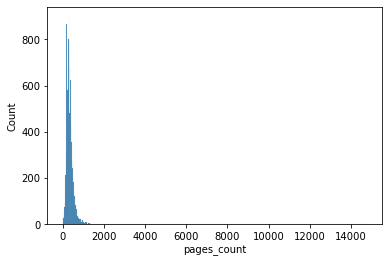

In [68]:
import seaborn as sns
import matplotlib.pyplot as plt

print(books_df_with_og_title['pages_count'].min())
print(books_df_with_og_title['pages_count'].max())

sns.histplot(books_df_with_og_title['pages_count'])
plt.show()

<p>
As can be seen, the distribution can show us that there are many outliers (i.e: some having 14k when the most has less than 1k)
So we are going to use median (mean might be too high).
And as can be seen, the pages_count has wrong dtype, float instead of int, let's fix it too.
</p>

In [69]:
books_df_without_missing_values = books_df_with_og_title.copy()

pages_count_median = books_df_without_missing_values['pages_count'].median()
books_df_without_missing_values['pages_count'] = np.where(
    books_df_without_missing_values['pages_count'].isnull(),
    pages_count_median,
    books_df_without_missing_values['pages_count']
)

books_df_without_missing_values = books_df_without_missing_values.astype({"pages_count": int})
print(f"median {books_df_without_missing_values['pages_count'].median()}")
books_df_without_missing_values.info()

median 327.0
<class 'pandas.core.frame.DataFrame'>
Int64Index: 16316 entries, 0 to 999
Data columns (total 22 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   title                    16316 non-null  object 
 1   original_title           16316 non-null  object 
 2   rating                   16316 non-null  float64
 3   ratings_count            16316 non-null  int64  
 4   reviews_count            16316 non-null  int64  
 5   book_format              16275 non-null  object 
 6   pages_count              16316 non-null  int64  
 7   main_language            16316 non-null  object 
 8   editions_count           16316 non-null  int64  
 9   has_awards               16316 non-null  bool   
 10  top_tagged_genre_1       16316 non-null  object 
 11  top_tagged_genre_2       16316 non-null  object 
 12  top_tagged_genre_3       16316 non-null  object 
 13  to_read_count            16316 non-null  int64  
 14  currently_r

<p>
Let's fix null of book_format, using top value as mentioned before.
</p>

In [70]:
most_freq_book_format = books_df_without_missing_values['book_format'].mode()[0]
books_df_without_missing_values['book_format'] = books_df_without_missing_values['book_format'].fillna(most_freq_book_format)
books_df_without_missing_values.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 16316 entries, 0 to 999
Data columns (total 22 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   title                    16316 non-null  object 
 1   original_title           16316 non-null  object 
 2   rating                   16316 non-null  float64
 3   ratings_count            16316 non-null  int64  
 4   reviews_count            16316 non-null  int64  
 5   book_format              16316 non-null  object 
 6   pages_count              16316 non-null  int64  
 7   main_language            16316 non-null  object 
 8   editions_count           16316 non-null  int64  
 9   has_awards               16316 non-null  bool   
 10  top_tagged_genre_1       16316 non-null  object 
 11  top_tagged_genre_2       16316 non-null  object 
 12  top_tagged_genre_3       16316 non-null  object 
 13  to_read_count            16316 non-null  int64  
 14  currently_reading_count 

<h3>Great</h3>
<p>We don't have any missing values anymore</p>
<p>However, We didn't finsih our cleaing session yet, we still may have some outliers (we sure do as we have seen in the historam for pages_count) to be cleaned.</p>

<a id='outliers_detection_eda'></a>
<h1>Pre-outliers cleaning EDA</h1>
<p>
    At this point we knew we had to get rid of outliers, we thought it will be the best to check the outliers and show them by doing some EDA.<br>
    Also, EDA shows us the current state of the data.
</p>

<a id='genre_distribution'></a>
<h3>Genres distribution</h3>

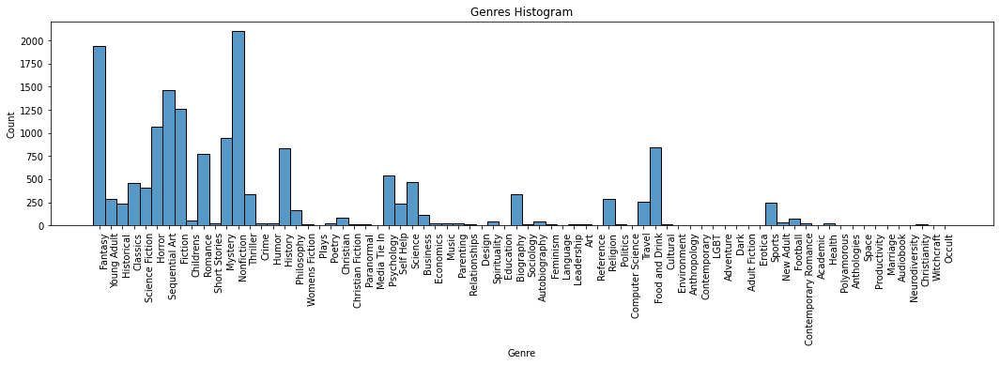

In [71]:
fig, ax = plt.subplots(figsize=(18, 4))
fg = sns.histplot(books_df_without_missing_values['top_tagged_genre_1'], ax=ax)
fg.set_title("Genres Histogram")
fg.set_xlabel("Genre")
plt.xticks(rotation=90, ha='right', rotation_mode='anchor')
plt.show()

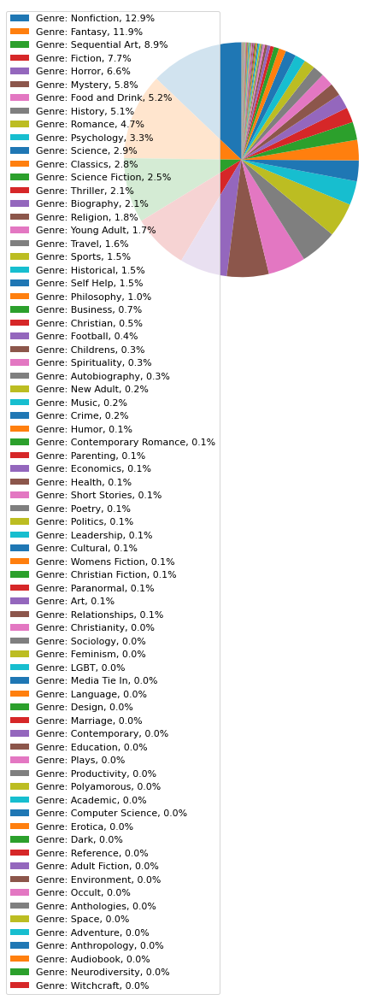

In [72]:
books_genre_counts = books_df_without_missing_values['top_tagged_genre_1'].value_counts()

total_books = books_df_without_missing_values.shape[0]

labels = ["Genre: %s" % i for i in books_genre_counts.index]

fig1, ax1 = plt.subplots(figsize=(6, 5))
fig1.subplots_adjust(0.3,0,1,1)

_, _ = ax1.pie(books_genre_counts.values, startangle=90)

ax1.axis('equal')

plt.legend(
    loc='upper left',
    labels=['%s, %1.1f%%' % (
        l, (v / total_books * 100)) for l, s, v in zip(labels, books_genre_counts.index, books_genre_counts.values)],
    prop={'size': 11},
    bbox_to_anchor=(0.0, 1),
    bbox_transform=fig1.transFigure
)

plt.show()

<a id='mean_rating_by_genre'></a>
<p>
   As can be seen, most of the books are either Fantasy or Nonfiction books.<br>
</p>
<h3>Mean rating by genre</h3>

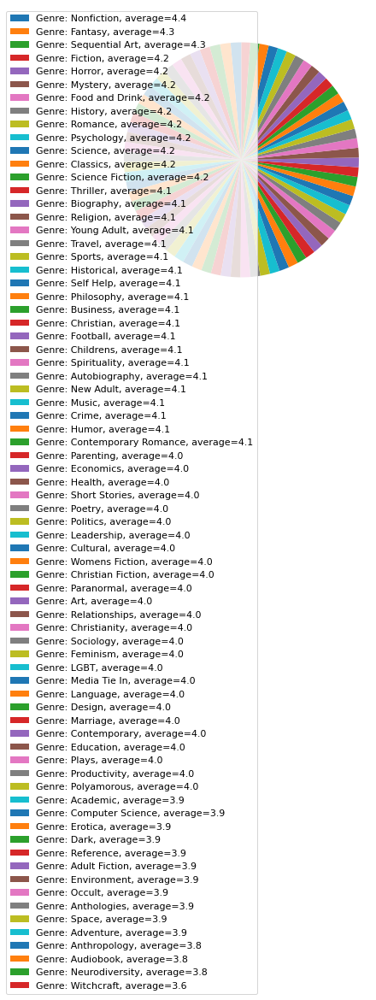

In [73]:
books_rating_mean_by_genre = books_df_without_missing_values.groupby('top_tagged_genre_1', as_index=False)['rating'].mean()
books_rating_mean_by_genre.sort_values(by="rating", inplace=True, ascending=False)

labels = ["Genre: %s" % i for i in books_genre_counts.index]

fig1, ax1 = plt.subplots(figsize=(6, 5))
fig1.subplots_adjust(0.3,0,1,1)

_, _ = ax1.pie(books_rating_mean_by_genre['rating'].tolist(), startangle=90)

ax1.axis('equal')

plt.legend(
    loc='upper left',
    labels=['%s, average=%1.1f' % (
        l, (v)) for l, s, v in zip(labels, books_rating_mean_by_genre.index, books_rating_mean_by_genre['rating'].tolist())],
    prop={'size': 11},
    bbox_to_anchor=(0.0, 1),
    bbox_transform=fig1.transFigure
)

plt.show()


<a id='language_distribution'></a>
<p>
    As can be seen, some of the genres have average rating higher than the others.<br>
    Maybe maybe it could help us later in building a model.
</p>
<h3>Language ditribution</h3>

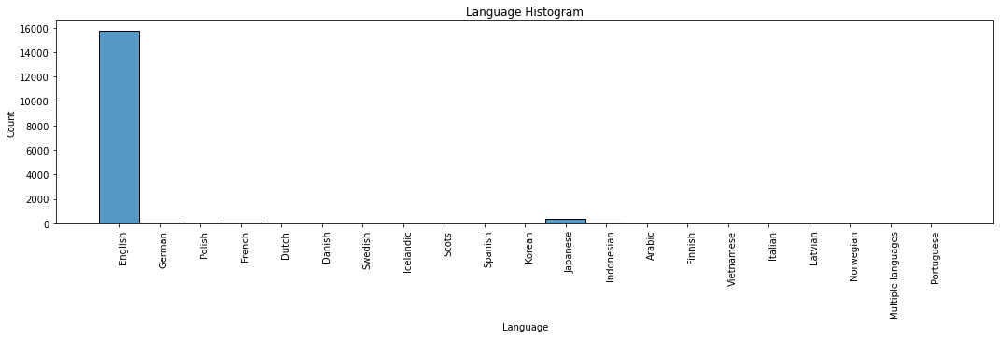

In [74]:
fig, ax = plt.subplots(figsize=(18, 4))
fg = sns.histplot(books_df_without_missing_values['main_language'], ax=ax)
fg.set_title("Language Histogram")
fg.set_xlabel("Language")
plt.xticks(rotation=90, ha='right', rotation_mode='anchor')
plt.show()

<a id='edition_count_to_rating'></a>
<p>
    Not to our surprise, by far the most used language is English, maybe it's related to the fact it's the most widely used language in the world.
</p>
<h3>Edition count to rating</h3>
<p>
    The idea behind this graph was to check for possible correlation between the two.<br>
</p>    

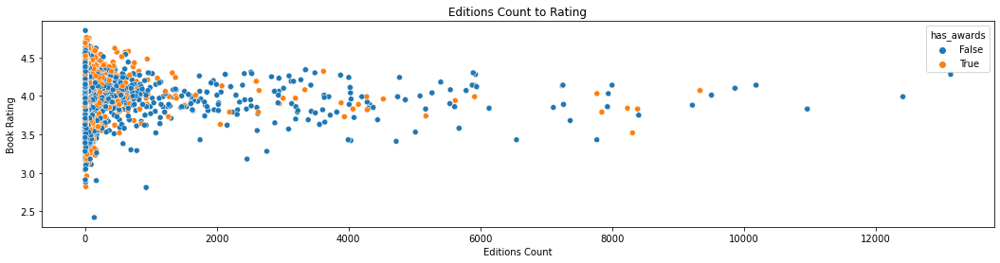

In [75]:
fig, ax = plt.subplots(figsize=(18, 4))
fg = sns.scatterplot(data=books_df_without_missing_values, x='editions_count', y='rating', hue='has_awards', ax=ax)
fg.set_title("Editions Count to Rating")
fg.set_xlabel("Editions Count")
fg.set_ylabel("Book Rating")
plt.show()

<p>
    let's take a closer look at the graph.
</p>   

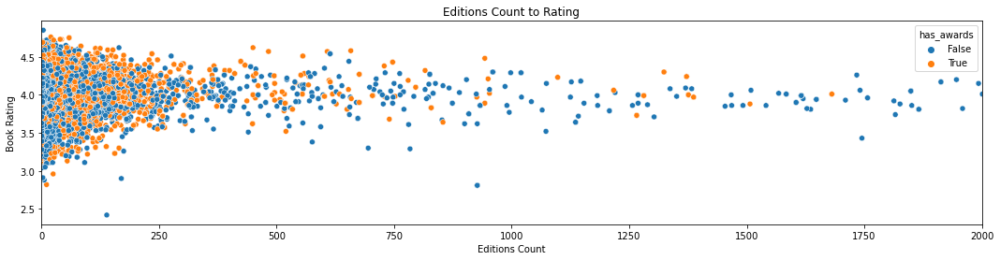

In [76]:
fig, ax = plt.subplots(figsize=(18, 4))
fg = sns.scatterplot(data=books_df_without_missing_values, x='editions_count', y='rating', hue='has_awards', ax=ax)
fg.set_title("Editions Count to Rating")
fg.set_xlim(0, 2000)
fg.set_xlabel("Editions Count")
fg.set_ylabel("Book Rating")
plt.show()

<a id='rating_to_award'></a>
<p>
    As can be seen, most of the books which having awards are having less than 250 editions (which makes sense).
</p>
<h3>Rating to award</h3>
<p>
    Another EDA which we thought will help us building a prediction model later on.
</p>   

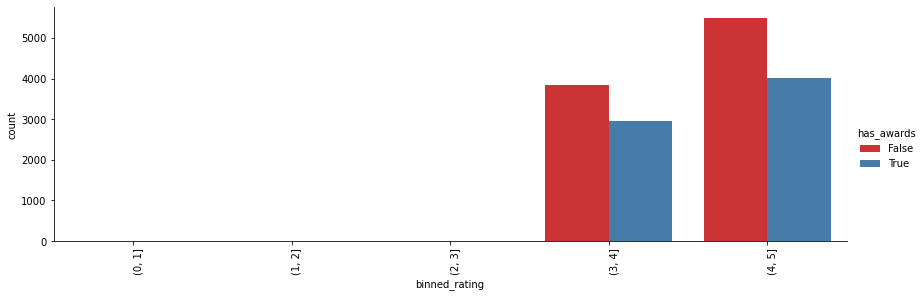

min rating: 2.42


In [77]:
binned_books_df = books_df_without_missing_values.copy()
binned_books_df['binned_rating'] = pd.cut(binned_books_df['rating'], [0, 1, 2, 3, 4, 5])
fg = sns.catplot(kind='count', data=binned_books_df,
                x='binned_rating', hue='has_awards', palette='Set1', height=4, aspect=3)
plt.xticks(rotation=90, ha='right', rotation_mode='anchor')
plt.show()
print(f"min rating: {books_df_without_missing_values['rating'].min()}")

<a id='pages_count_to_books_count'></a>
<p>
    As can be seen, altough books has atleast 2.42 rating, below the rating 3,there is not even a chance for getting award.<br>
    This information is great for us.
</p>
<h3>Pages count to books count</h3>
<p>
    As part of checking some more ideas of what can lead to outliers and help the prediction model we decided to check the books pages count and we then saw this.
</p>

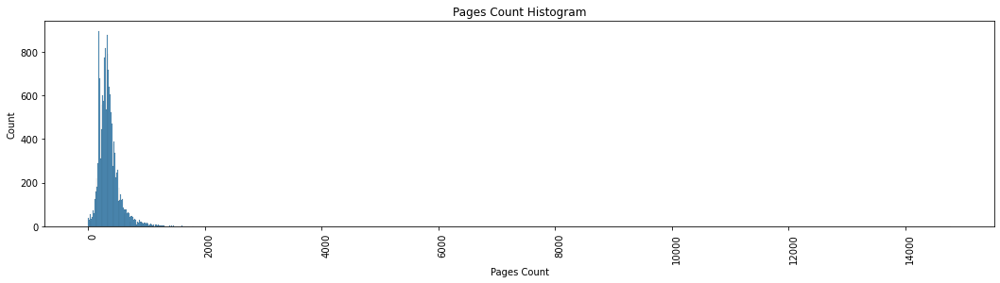

In [78]:
fig, ax = plt.subplots(figsize=(18, 4))
fg = sns.histplot(books_df_without_missing_values['pages_count'], ax=ax)
fg.set_title("Pages Count Histogram")
fg.set_xlabel("Pages Count")
plt.xticks(rotation=90, ha='right', rotation_mode='anchor')
plt.show()

<p>
    This kind of data is exactly why we need to remove outliers.<br>
    This leads us to show all the outliers which we might have, based on the data of each coloumn individually.<br>
    Anyway, altough because of the data spewing, we probably choose median over mean (which may be very high because of the outliers).
    </p>

<p>let's have a look on both</p>

In [79]:

print(f"mean: {books_df_without_missing_values['pages_count'].mean()}")
print(f"median: {books_df_without_missing_values['pages_count'].median()}")


mean: 358.440916891395
median: 327.0


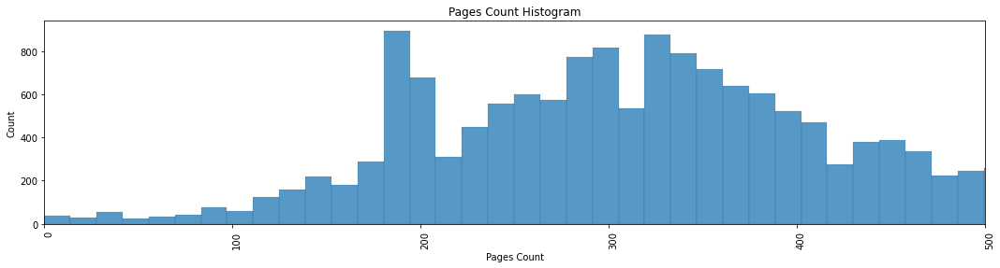

In [80]:
fig, ax = plt.subplots(figsize=(18, 4))
fg = sns.histplot(books_df_without_missing_values['pages_count'], ax=ax)
fg.set_title("Pages Count Histogram")
fg.set_xlabel("Pages Count")
fg.set_xlim(0, 500)
plt.xticks(rotation=90, ha='right', rotation_mode='anchor')

plt.show()

<p>It seems like the median is closer to the peak area more than the mean, however let's zoom in even further</p>

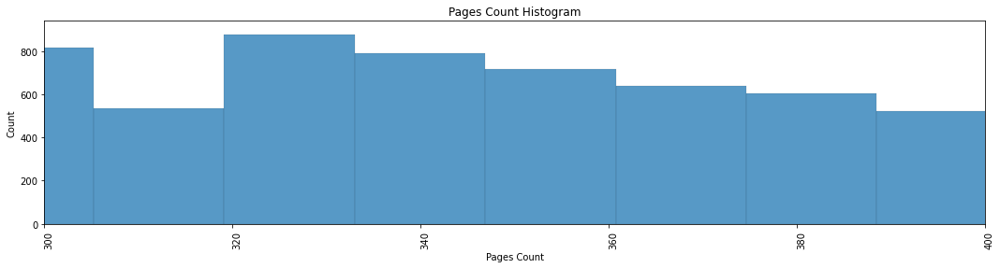

In [81]:
fig, ax = plt.subplots(figsize=(18, 4))
fg = sns.histplot(books_df_without_missing_values['pages_count'], ax=ax)
fg.set_title("Pages Count Histogram")
fg.set_xlabel("Pages Count")
fg.set_xlim(300, 400)
plt.xticks(rotation=90, ha='right', rotation_mode='anchor')

plt.show()

<p>Now, as it can be seen: the median really is seem to be more common (even with the amount of records we have)</p>

<a id='dealing_with_outliers'></a>
<p>
    <h2>Dealing with outliers</h2>
    In this secion, we are going to:<br>
    <ol>
        <li>Detect Outliers in all of our numeruic data and present them by using Boxplots.</li>
        <li>Using IQR which is going to replace all numeric cols items which their values are below the 25 percentile or above 75 percentile with median.</li>
    </ol>    
</p>
<h3>Outliers detection</h3>

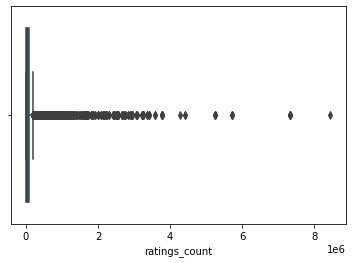

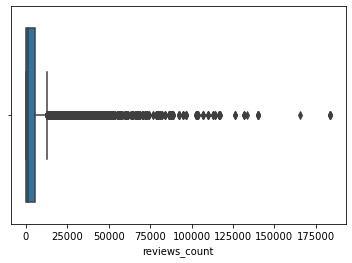

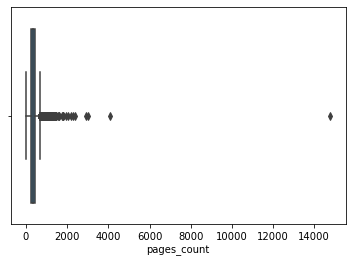

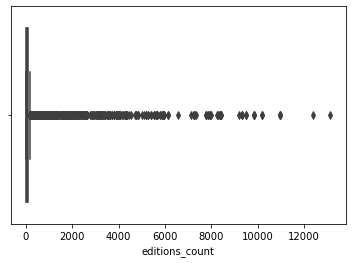

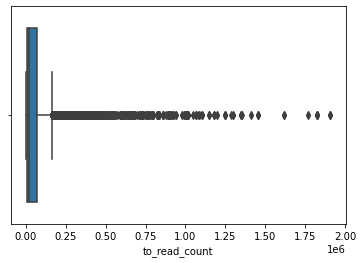

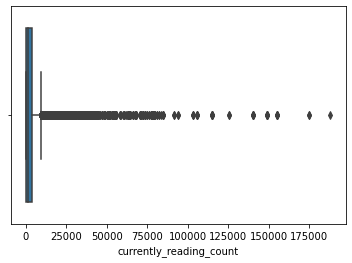

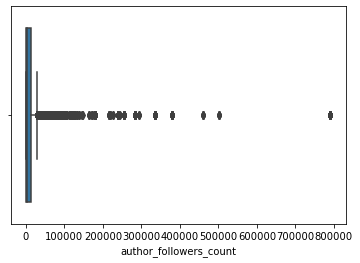

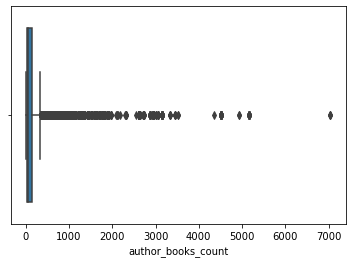

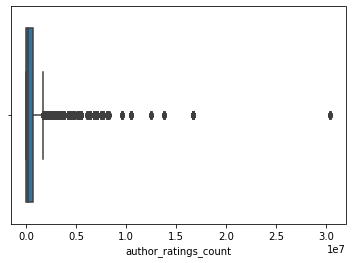

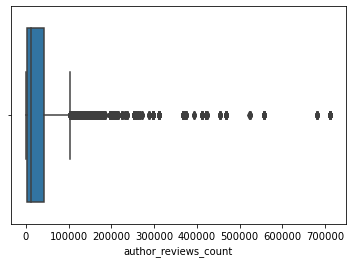

In [82]:
def display_numeric_boxplots(df, excluded):
    numeric_columns = df.select_dtypes(['float64', 'int64']).columns
    excluded = set(excluded)
    for col in numeric_columns:
        if col in excluded:
            continue
        sns.boxplot(x=df[col])
        plt.show()
display_numeric_boxplots(books_df_without_missing_values, ['rating', 'author_avg_rating'])

<a id='outliers_cleaning'></a>
<h3>Outliers Cleaning</h3>
<p>
    At first we wanted to do replacement of the values under Q1 and values above Q3 will be replaced with median.<br>
    Yet, this approach would have been unfair for the great authors such as: J.K rolling and William Shakespeare which earned their crowd population respectfully, By replacing their values with medians we would have ruin the data and may also harm our future prediction model.<br>
    So in order to keep our data as realistic as we can and at the same time remove outliers we decided to use capping instead of medians, that way the great authors will not be downgraded by too much.<br>
    Another approach we wanted to try out was z-score and mean, reason doing that was since we knew the z-score model keeps around 99% of the population as non-outliers (in case of normal distribution) it would detect "real" outliers.<br>
    So in order to decide which approach's data we want to use for the prediction model we decided to try them both and compare the data's skew after each of them.
</p>

In [87]:
def replace_top_outliers_iqr(df, excluded):
    updated_df = df.copy()
    numeric_columns = updated_df.select_dtypes(['float64', 'int64']).columns
    excluded = set(excluded)
    for col in numeric_columns:
        if col in excluded:
            continue
        Q1 = np.percentile(updated_df[col], 25)
        Q3 = np.percentile(updated_df[col], 75)
        IQR = Q3 - Q1
        IQR_range = 1.5 * IQR
        updated_df.loc[(updated_df[col] < Q1 - IQR_range), [col]] = Q1
        updated_df.loc[(updated_df[col] > Q3 + IQR_range), [col]] = Q3
    return updated_df

def replace_outliers_with_mean_using_zscore(df, excluded):
    updated_df = df.copy()
    numeric_columns = updated_df.select_dtypes(['float64', 'int64']).columns
    excluded = set(excluded)
    for col in numeric_columns:
        if col in excluded:
            continue
        z_score = (updated_df[col] - updated_df[col].mean()) / updated_df[col].std()
        outliers = abs(z_score) > 3
        mean = updated_df[col].mean()
        if updated_df[col].dtype == 'int64':
            mean = int(mean)
        updated_df.loc[outliers, [col]] = mean
        
    return updated_df

excluded = ['rating', 'author_avg_rating']

fixed_outliers_books_df_capped_iqr = replace_top_outliers_iqr(
    books_df_without_missing_values,
    excluded
)

fixed_outliers_books_df_zscore = replace_outliers_with_mean_using_zscore(
    books_df_without_missing_values,
    excluded
)

def print_numeric_cols_skew(df): 
    numeric_columns = df.select_dtypes(['float64', 'int64']).columns
    
    for col in numeric_columns:
        print(f"{col}: {df[col].skew()}")
    

print("regular -------")
print_numeric_cols_skew(books_df_without_missing_values)
print("capped iqr -------")
print_numeric_cols_skew(fixed_outliers_books_df_capped_iqr)
print("zscore -------")
print_numeric_cols_skew(fixed_outliers_books_df_zscore)

regular -------
rating: -0.31112862828346455
ratings_count: 8.971843702199587
reviews_count: 5.040289224487523
pages_count: 20.271276180496592
editions_count: 10.45877719581811
to_read_count: 4.8095183834963375
currently_reading_count: 6.375684822748882
author_followers_count: 6.67216557644158
author_books_count: 5.426577263012842
author_avg_rating: -0.2029748677016511
author_ratings_count: 5.437158078340494
author_reviews_count: 4.267591106533465
capped iqr -------
rating: -0.31112862828346455
ratings_count: 1.2871777171048828
reviews_count: 1.2535537900583364
pages_count: 0.2749065618694054
editions_count: 0.9910075427588525
to_read_count: 1.2256776927321846
currently_reading_count: 1.2561146907178304
author_followers_count: 1.3009672934651775
author_books_count: 1.1160845768959375
author_avg_rating: -0.2029748677016511
author_ratings_count: 1.232327895143438
author_reviews_count: 1.2460134977915578
zscore -------
rating: -0.31112862828346455
ratings_count: 3.4517930642515644
reviews

<p>As expected, capped IQR seems to be the best when it comes to skewing consideration</p>

<p>now we can proceed.</p>

<p>Let's visualize again the problematic pages_count metric after outliers cleaning</p>

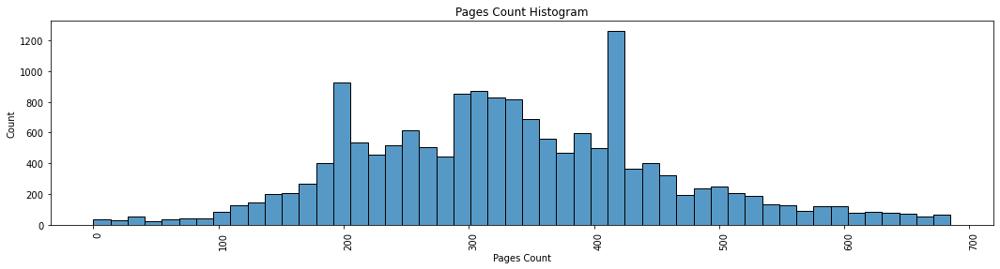

,rating,ratings_count,reviews_count,pages_count,editions_count,to_read_count,currently_reading_count,author_followers_count,author_books_count,author_avg_rating,author_ratings_count,author_reviews_count
count,16316.000000,16316.000000,16316.000000,16316.000000,16316.000000,16316.000000,16316.000000,16316.000000,16316.000000,16316.000000,1.631600e+04,16316.000000
mean,4.047275,40124.220091,2681.379505,333.748774,43.113140,33482.523780,2001.120250,5672.390537,76.940120,4.048311,3.393447e+05,21345.637227
std,0.249599,44177.972572,2923.607765,122.373708,37.147111,36207.027521,2134.448389,6629.075176,72.198411,0.207330,3.805287e+05,23460.780467
min,2.420000,57.000000,2.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,3.070000,8.300000e+01,7.000000
25%,3.890000,4979.000000,341.000000,245.000000,13.000000,4855.000000,281.750000,444.000000,18.000000,3.930000,2.905475e+04,2302.000000
50%,4.060000,20057.500000,1360.000000,327.000000,31.000000,16590.000000,1098.500000,2426.000000,49.000000,4.050000,1.667920e+05,11935.500000
75%,4.210000,81367.000000,5392.250000,421.000000,74.000000,67438.125000,3968.000000,11934.000000,146.000000,4.180000,6.944250e+05,42317.125000
max,4.850000,195893.000000,12966.000000,685.000000,165.000000,160884.000000,9489.000000,28677.000000,338.000000,4.730000,1.685399e+06,102202.000000


In [88]:
fig, ax = plt.subplots(figsize=(18, 4))
fg = sns.histplot(fixed_outliers_books_df_capped_iqr['pages_count'], ax=ax)
fg.set_title("Pages Count Histogram")
fg.set_xlabel("Pages Count")
plt.xticks(rotation=90, ha='right', rotation_mode='anchor')
plt.show()
fixed_outliers_books_df_capped_iqr.describe()

<a id='outliers_clean_results'></a>
<h3>Outliers cleaning results</h3>
<p>
    After the clean-up, Here are the coloums data without outliers.
</p>

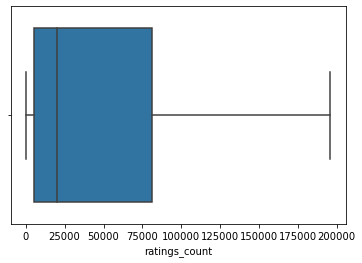

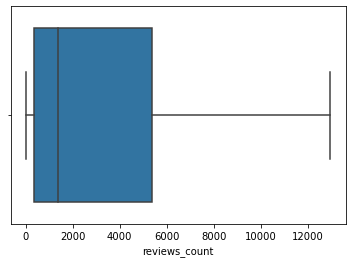

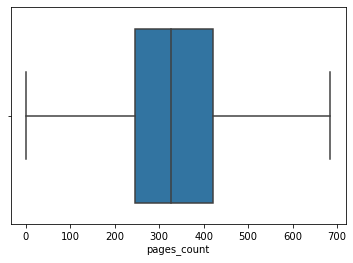

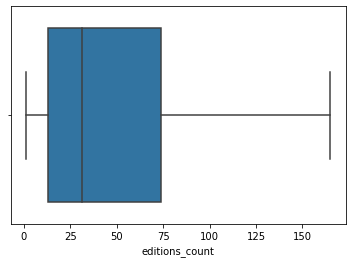

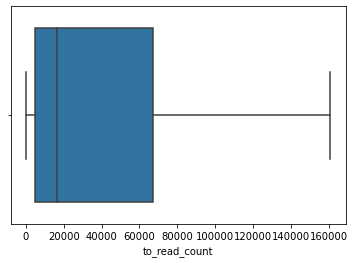

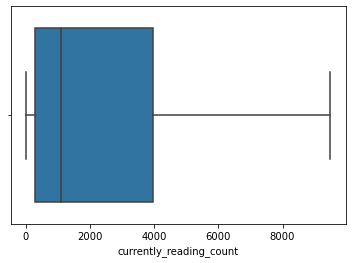

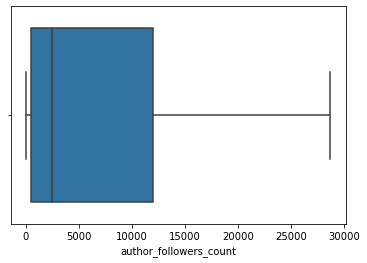

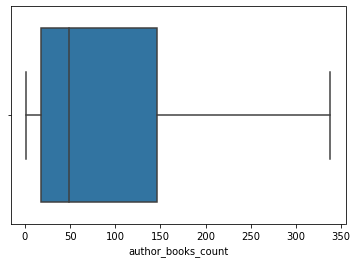

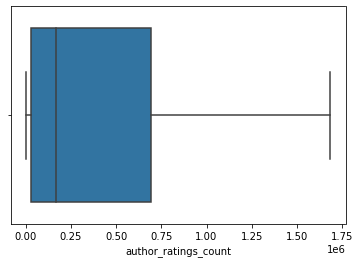

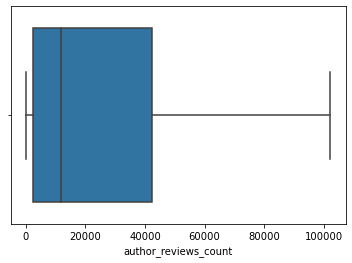

In [89]:
display_numeric_boxplots(fixed_outliers_books_df_capped_iqr, excluded)


<h3>Data cleaning finished</h3>
<p>We are done with the cleaning process, le'ts save it</p>

In [90]:
fixed_outliers_books_df_capped_iqr.to_parquet("./clean_books.parquet")

<a id='after_clean_eda'></a>
<h2>After cleaning EDA</h2>
<p>
    Now when the data is clean it's time to see how far we have accomplished by now and show all the stats we have based on the data acquired.
</p>    

In [34]:
clean_books = pd.read_parquet("./clean_books.parquet")
display(clean_books)

,title,original_title,rating,ratings_count,reviews_count,book_format,pages_count,main_language,editions_count,has_awards,...,top_tagged_genre_3,to_read_count,currently_reading_count,author_name,author_followers_count,author_books_count,author_avg_rating,author_ratings_count,author_reviews_count,is_title_changed
0,Harry Potter and the Sorcerer's Stone,Harry Potter and the Philosopher's Stone,4.48,81367.0,5393.0,Hardcover,309.0,English,74.0,True,...,Young Adult,67438.0,3968.0,J.K. Rowling,11934.0,221.0,4.46,694425.0,42326.0,True
1,Harry Potter and the Chamber of Secrets,Harry Potter and the Chamber of Secrets,4.43,81367.0,5393.0,Hardcover,341.0,English,74.0,True,...,Young Adult,67438.0,3968.0,J.K. Rowling,11934.0,221.0,4.46,694425.0,42326.0,False
2,Harry Potter and the Prisoner of Azkaban,Harry Potter and the Prisoner of Azkaban,4.58,81367.0,5393.0,Mass Market Paperback,435.0,English,74.0,True,...,Fiction,67438.0,3968.0,J.K. Rowling,11934.0,221.0,4.46,694425.0,42326.0,False
3,"The Hobbit, or There and Back Again","The Hobbit, or There and Back Again",4.28,81367.0,5393.0,Paperback,366.0,English,50.0,True,...,Fiction,67438.0,3968.0,J.R.R. Tolkien,11934.0,146.0,4.35,694425.0,42326.0,False
4,Harry Potter and the Goblet of Fire,Harry Potter and the Goblet of Fire,4.57,81367.0,5393.0,Paperback,421.0,English,74.0,True,...,Fiction,67438.0,3968.0,J.K. Rowling,11934.0,221.0,4.46,694425.0,42326.0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
993,Mrs. Fields Cookie Book,Mrs. Fields Cookie Book,4.22,1259.0,35.0,Paperback,120.0,English,2.0,False,...,Food and Drink,1218.0,13.0,Debbi Fields,7.0,11.0,4.18,1497.0,60.0,False
994,"My Korea: Traditional Flavors, Modern Recipes","My Korea: Traditional Flavors, Modern Recipes",4.12,83.0,11.0,Hardcover,352.0,English,2.0,False,...,Food and Drink,328.0,77.0,Hooni Kim,0.0,1.0,4.12,83.0,11.0,False
996,Cook It in Your Dutch Oven: 150 Foolproof Reci...,Cook It in Your Dutch Oven: 150 Foolproof Reci...,3.91,291.0,46.0,Kindle Edition,327.0,English,3.0,False,...,Food and Drink,267.0,322.0,America's Test Kitchen,453.0,199.0,4.19,54393.0,3005.0,False
998,Taste & Technique: Recipes to Elevate Your Hom...,Taste & Technique: Recipes to Elevate Your Hom...,4.16,194.0,31.0,Kindle Edition,400.0,English,3.0,False,...,Food and Drink,294.0,137.0,Naomi Pomeroy,3.0,1.0,4.16,194.0,31.0,False


In [35]:
display(clean_books.describe())

,rating,ratings_count,reviews_count,pages_count,editions_count,to_read_count,currently_reading_count,author_followers_count,author_books_count,author_avg_rating,author_ratings_count,author_reviews_count
count,16316.000000,16316.000000,16316.000000,16316.000000,16316.000000,16316.000000,16316.000000,16316.000000,16316.000000,16316.000000,1.631600e+04,16316.000000
mean,4.047275,40124.220091,2681.379505,333.748774,43.170017,33482.463778,2001.120250,5672.390537,76.940120,4.048311,3.393447e+05,21345.579002
std,0.249599,44177.972572,2923.607765,122.373708,37.210177,36206.971246,2134.448389,6629.075176,72.198411,0.207330,3.805287e+05,23460.728394
min,2.420000,57.000000,2.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,3.070000,8.300000e+01,7.000000
25%,3.890000,4979.000000,341.000000,245.000000,13.000000,4855.000000,281.750000,444.000000,18.000000,3.930000,2.905475e+04,2302.000000
50%,4.060000,20057.500000,1360.000000,327.000000,31.000000,16590.000000,1098.500000,2426.000000,49.000000,4.050000,1.667920e+05,11935.500000
75%,4.210000,81367.000000,5392.250000,421.000000,74.000000,67438.000000,3968.000000,11934.000000,146.000000,4.180000,6.944250e+05,42317.000000
max,4.850000,195893.000000,12966.000000,685.000000,165.000000,160884.000000,9489.000000,28677.000000,338.000000,4.730000,1.685399e+06,102202.000000


In [36]:
clean_books.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 16316 entries, 0 to 999
Data columns (total 22 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   title                    16316 non-null  object 
 1   original_title           16316 non-null  object 
 2   rating                   16316 non-null  float64
 3   ratings_count            16316 non-null  float64
 4   reviews_count            16316 non-null  float64
 5   book_format              16316 non-null  object 
 6   pages_count              16316 non-null  float64
 7   main_language            16316 non-null  object 
 8   editions_count           16316 non-null  float64
 9   has_awards               16316 non-null  bool   
 10  top_tagged_genre_1       16316 non-null  object 
 11  top_tagged_genre_2       16316 non-null  object 
 12  top_tagged_genre_3       16316 non-null  object 
 13  to_read_count            16316 non-null  float64
 14  currently_reading_count 

<a id='thoughts_after_clean'></a>
<h3>Thoughts</h3>
<p>
    Based on what we saw in the description of the DataFrame we were happy with the results.<br>
    All the numbers were adding up to reasonable numbers and the percentiles values for each data coloumn are exactly how we wanted them.<br>
    Also, just by looking at the DataFrame as it is, we started having guesses of how to predict if a book can be awarded or not.<br>
    Overall we were very satisfied with the results.

<a id='metrics_agg'></a>
<h3>Metrics aggregation by getting awarded</h3>
<p>
    We wanted to see how many books which has some metrics aggregated has awards or not.<br>
    Thus we decided to display these metrics.<br>
    The aggregation model is Ratio of:<br>
    <em>Sum of awarded books based on the metric / Total awarded books.</em><br>
    <strong>Note: we had to exclude rating and author average rating from the list due to the aggregation model lack of ability to sum a bounded value. </strong>
</p>

In [37]:
from typing import Any

def get_aggregative_relative_metric_against_target_col(df: pd.DataFrame, metric_col: str, target_col: str, val: bool) -> Any:
    split_df = df[df[target_col] == val]

    total_metric_count = np.sum(split_df[metric_col])
    
    ratio_of_aggregated_metric_to_split_count = int(total_metric_count / max(split_df.shape[0], 1))
    
    return int(ratio_of_aggregated_metric_to_split_count)

def titlize(text: str) -> str:
    return text.replace("_", " ").title()

def display_histogram_of_aggregative_metric_against_flag_column(df: pd.DataFrame, metric_col: str, flag_col: str) -> Any:
    positives = get_aggregative_relative_metric_against_target_col(df, metric_col, flag_col, True)
    negatives = get_aggregative_relative_metric_against_target_col(df, metric_col, flag_col, False)
    x = np.arange(2)
    plt.bar(x, height=[negatives, positives], color=["red", "green"])
    plt.xticks(x, [f"Not {titlize(flag_col)}", titlize(flag_col)])
    plt.title(f"'{titlize(metric_col)}' Split by {titlize(flag_col)}")
    plt.show()


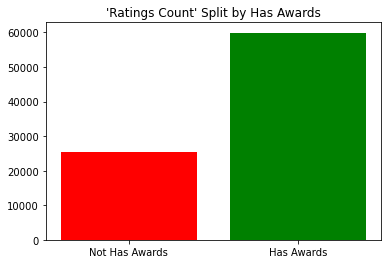

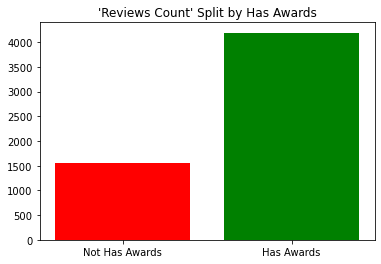

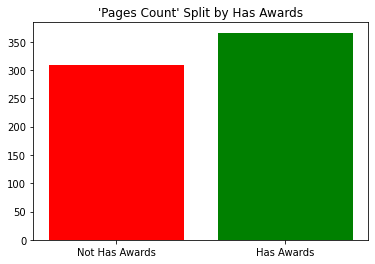

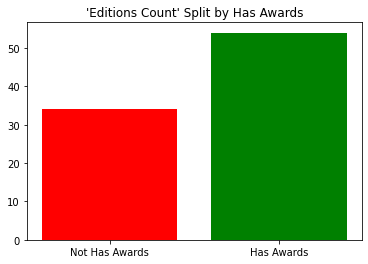

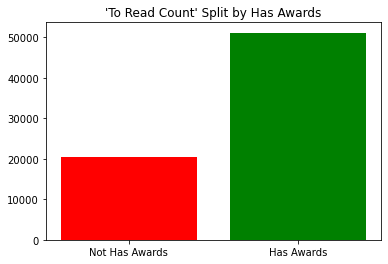

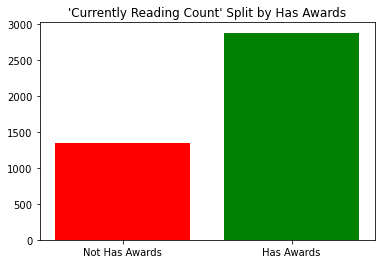

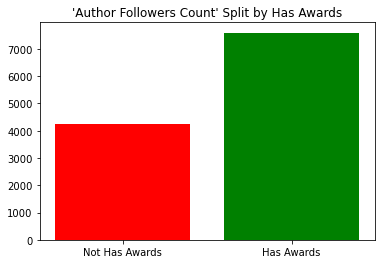

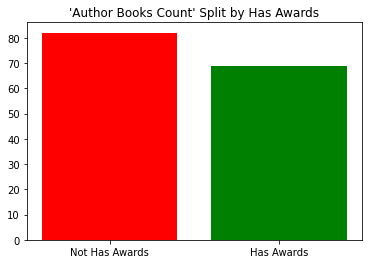

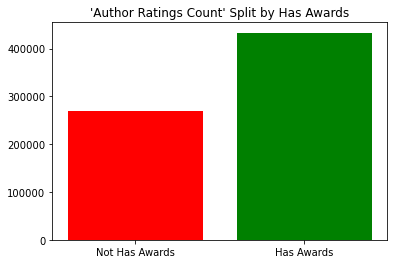

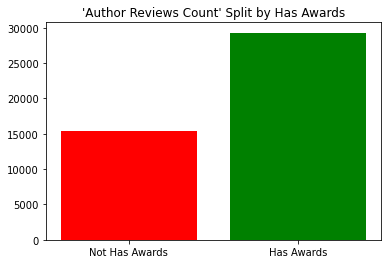

In [38]:
exclude = {
    "rating",
    "author_avg_rating"
}# because those are based on average and it will not reflect any changes

for metric in clean_books.select_dtypes(['float64', 'int64']):
    if metric in exclude:
        continue
    display_histogram_of_aggregative_metric_against_flag_column(clean_books, metric, "has_awards")


<a id='og_title_eff'></a>
<h3>Changing titles effectivness</h3>
<p>
    The question of how effective is it to change the name of the book was interesting to us from the beginning of this research.<br>
    Now we can finally check the correlation between changing the title to getting awards.
</p>    

,is_title_changed,has_awards
is_title_changed,1.000000,-0.174169
has_awards,-0.174169,1.000000


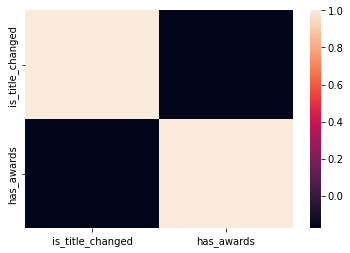

In [39]:
corr_between_is_title_changed_to_has_awards = clean_books[["is_title_changed", "has_awards"]].corr()
display(corr_between_is_title_changed_to_has_awards)
sns.heatmap(data=corr_between_is_title_changed_to_has_awards)
plt.show()

<a id='awards_count_to_genre'></a>
<p>
    As can be seen, there is no correlation in between these two, not all that is shining is gold.
</p>    
<h3>Count of awarded books per genre</h3>

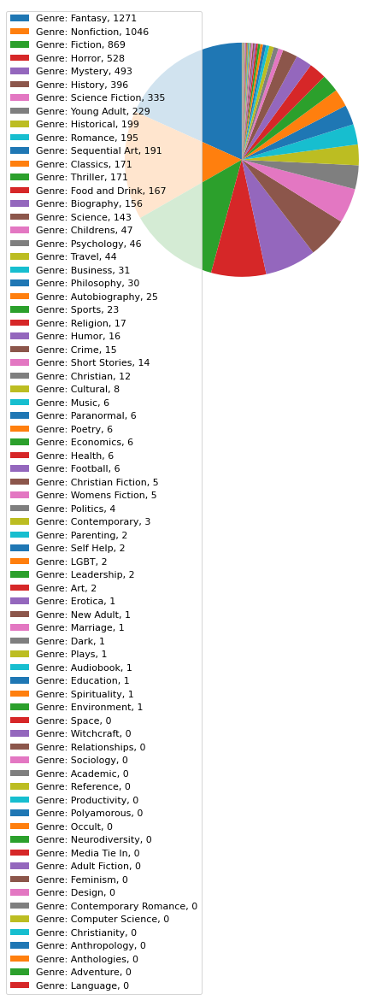

In [40]:
books_genre_counts = clean_books.groupby(by=['top_tagged_genre_1'])['has_awards'].sum().sort_values(ascending=False)

labels = ["Genre: %s" % i for i in books_genre_counts.index]

fig1, ax1 = plt.subplots(figsize=(6, 5))
fig1.subplots_adjust(0.3,0,1,1)

_, _ = ax1.pie(books_genre_counts.values, startangle=90)

ax1.axis('equal')

plt.legend(
    loc='upper left',
    labels=['%s, %d' % (
        l, v) for l, s, v in zip(labels, books_genre_counts.index, books_genre_counts.values)],
    prop={'size': 11},
    bbox_to_anchor=(0.0, 1),
    bbox_transform=fig1.transFigure
)

plt.show()

<a id='awards_book_by_percentage'></a>
<h3>Percentage of awarded books per genre</h3>

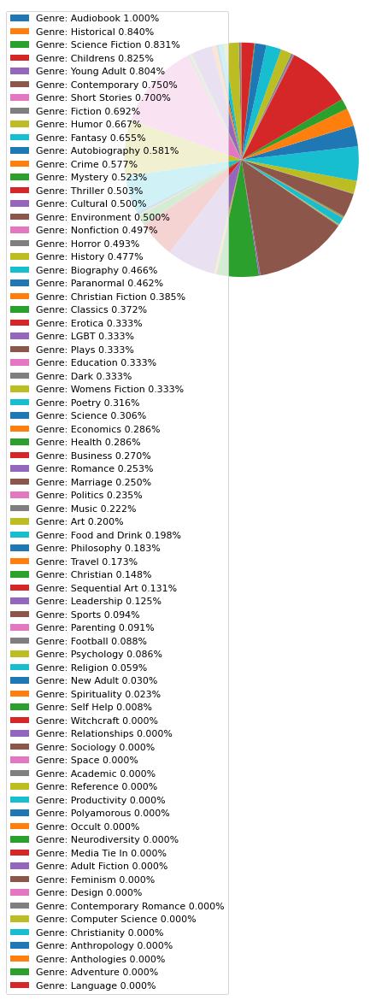

In [41]:
books_genre_has_awards_counts = clean_books.groupby(by=['top_tagged_genre_1'])['has_awards'].sum().sort_index()
books_genre_counts = clean_books['top_tagged_genre_1'].value_counts().sort_index()

books_genres_data = pd.DataFrame(
    {
        'genre': books_genre_counts.index,
        'has_awards': books_genre_has_awards_counts.values,
        'total': books_genre_counts.values,
        'has_awards_ratio_to_total': books_genre_has_awards_counts.values / books_genre_counts.values
    }
)
books_genres_data.sort_values(by='has_awards_ratio_to_total', ascending=False, inplace=True)

labels = ["Genre: %s" % i for i in books_genres_data['genre'].tolist()]

fig1, ax1 = plt.subplots(figsize=(6, 5))
fig1.subplots_adjust(0.3,0,1,1)

_, _ = ax1.pie(books_genre_counts.values, startangle=90)

ax1.axis('equal')

plt.legend(
    loc='upper left',
    labels=['%s %1.3f%%' % (
        l, v) for l, v in zip(labels, books_genres_data["has_awards_ratio_to_total"].tolist())],
    prop={'size': 11},
    bbox_to_anchor=(0.0, 1),
    bbox_transform=fig1.transFigure
)

plt.show()
# notice, audiobook is a genre

<a id='machine_learning_prep'></a>
<h1>Machine Learning model - Preperation</h1>
<p>
    Finally, time to make some predictions.<br>
    The method we wanted to use as our machine learning was decisions tree.<br>
    Reasons we chose this method were:<br>
    <ul>
        <li>This model can be used for classification.</li>
        <li>Very simple and intuitive.</li>
        <li>Using random forest to stimulate cross validation</li>
     </ul>
    Yet, we still had to do some data modifications before creating a machine learning model that can predict if a book will be awarded.<br>
    First, We planned to eliminate coloums whatever not relevant to the prediction model:
    <ul>
        <li>title</li>
        <li>original title</li>
    </ul>
</p>    

In [42]:
preprocessed_books = clean_books.copy().drop(columns=["original_title", "title"])

<p>
    After that we want to be able to use a boolean based features in our DataFrame as value based coloums.<br>
    These booleans are:
    <ul>
        <li>has_awards</li>
        <li>is_title_changed</li>
    </ul>
    So in order to make it booleanish we deciced True value will be presented as 1 and False value will be presented as 0.
</p>    

In [43]:
def bool_to_int(df, col_name):
    updated_df = df.copy()
    updated_df[col_name] = np.where(
        updated_df[col_name] == True,
        1,
        0
    ).astype('int64')
    return updated_df

preprocessed_books = bool_to_int(preprocessed_books, "is_title_changed")
preprocessed_books = bool_to_int(preprocessed_books, "has_awards")

<p>
    Last but not least, We had to do label encoings to all object type columns so they will fit the form for the machine learning model.
</p>    

In [44]:
def label_encode_df_col_inplace(df, col):
    df[col] = LabelEncoder().fit_transform(df[col])

for col in ["book_format", "main_language", "top_tagged_genre_1", "top_tagged_genre_2", "top_tagged_genre_3", "author_name", "is_title_changed", "has_awards"]:
    label_encode_df_col_inplace(preprocessed_books, col)


In [45]:
preprocessed_books

,rating,ratings_count,reviews_count,book_format,pages_count,main_language,editions_count,has_awards,top_tagged_genre_1,top_tagged_genre_2,top_tagged_genre_3,to_read_count,currently_reading_count,author_name,author_followers_count,author_books_count,author_avg_rating,author_ratings_count,author_reviews_count,is_title_changed
0,4.48,81367.0,5393.0,10,309.0,3,74.0,1,26,53,228,67438.0,3968.0,2282,11934.0,221.0,4.46,694425.0,42326.0,1
1,4.43,81367.0,5393.0,10,341.0,3,74.0,1,26,53,228,67438.0,3968.0,2282,11934.0,221.0,4.46,694425.0,42326.0,0
2,4.58,81367.0,5393.0,16,435.0,3,74.0,1,26,156,85,67438.0,3968.0,2282,11934.0,221.0,4.46,694425.0,42326.0,0
3,4.28,81367.0,5393.0,18,366.0,3,50.0,1,26,27,85,67438.0,3968.0,2295,11934.0,146.0,4.35,694425.0,42326.0,0
4,4.57,81367.0,5393.0,18,421.0,3,74.0,1,26,156,85,67438.0,3968.0,2282,11934.0,221.0,4.46,694425.0,42326.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
993,4.22,1259.0,35.0,18,120.0,3,2.0,0,29,35,90,1218.0,13.0,1336,7.0,11.0,4.18,1497.0,60.0,0
994,4.12,83.0,11.0,10,352.0,3,2.0,0,29,35,90,328.0,77.0,2172,0.0,1.0,4.12,83.0,11.0,0
996,3.91,291.0,46.0,11,327.0,3,3.0,0,29,35,90,267.0,322.0,250,453.0,199.0,4.19,54393.0,3005.0,0
998,4.16,194.0,31.0,11,400.0,3,3.0,0,29,35,90,294.0,137.0,4119,3.0,1.0,4.16,194.0,31.0,0


<h3>Terrific</h3>
<p>
    Our DataFrame is now ready for machine learning model.<br>
    Let's save the DataFrame and create the prediction model.
</p>

In [46]:
preprocessed_books.to_parquet("./preprocessed_books.parquet")

In [47]:
preprocessed_books = pd.read_parquet("./preprocessed_books.parquet")

In [48]:
preprocessed_books

,rating,ratings_count,reviews_count,book_format,pages_count,main_language,editions_count,has_awards,top_tagged_genre_1,top_tagged_genre_2,top_tagged_genre_3,to_read_count,currently_reading_count,author_name,author_followers_count,author_books_count,author_avg_rating,author_ratings_count,author_reviews_count,is_title_changed
0,4.48,81367.0,5393.0,10,309.0,3,74.0,1,26,53,228,67438.0,3968.0,2282,11934.0,221.0,4.46,694425.0,42326.0,1
1,4.43,81367.0,5393.0,10,341.0,3,74.0,1,26,53,228,67438.0,3968.0,2282,11934.0,221.0,4.46,694425.0,42326.0,0
2,4.58,81367.0,5393.0,16,435.0,3,74.0,1,26,156,85,67438.0,3968.0,2282,11934.0,221.0,4.46,694425.0,42326.0,0
3,4.28,81367.0,5393.0,18,366.0,3,50.0,1,26,27,85,67438.0,3968.0,2295,11934.0,146.0,4.35,694425.0,42326.0,0
4,4.57,81367.0,5393.0,18,421.0,3,74.0,1,26,156,85,67438.0,3968.0,2282,11934.0,221.0,4.46,694425.0,42326.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
993,4.22,1259.0,35.0,18,120.0,3,2.0,0,29,35,90,1218.0,13.0,1336,7.0,11.0,4.18,1497.0,60.0,0
994,4.12,83.0,11.0,10,352.0,3,2.0,0,29,35,90,328.0,77.0,2172,0.0,1.0,4.12,83.0,11.0,0
996,3.91,291.0,46.0,11,327.0,3,3.0,0,29,35,90,267.0,322.0,250,453.0,199.0,4.19,54393.0,3005.0,0
998,4.16,194.0,31.0,11,400.0,3,3.0,0,29,35,90,294.0,137.0,4119,3.0,1.0,4.16,194.0,31.0,0


<a id='machine_learning_single'></a>
<h1>Machine learning model - Single decision tree</h1>
<p>
    Our model for decision tree is based on 3 important utils:
    <ol>
        <li>The sklearn.tree module which includes decision tree-based models for classification. </li>
        <li>From the sklearn.model_selection we used train_test_split - Quick utility that wraps input validation and next(ShuffleSplit().split(X, y)) and application to input data into a single call for splitting (and optionally subsampling) data in a oneliner.<br>
        Which we wrapped with our own data splitter based on the features, labels and random state to our decisions.</li>
        <li>Rendring function which draws the decision tree.</li>
    </ol>
</p>
<p>
    Here you can see the splitting function and the rendering function.
</p>    

In [49]:
def splitData(df, features, labels, specifed_random_state=42):
    """Split a subset of the dataset, given by the features, into train and test sets."""
    df_predictors = df[features].values
    df_labels = df[labels].values

    # Split into training and test sets
    XTrain, XTest, yTrain, yTest = train_test_split(df_predictors, df_labels, random_state=specifed_random_state)
    return XTrain, XTest, yTrain, yTest

In [50]:
def renderTree(my_tree, features):
    # hacky solution of writing to files and reading again
    # necessary due to library bugs
    filename = "temp.dot"
    with open(filename, 'w') as f:
        f = tree.export_graphviz(my_tree, 
                                 out_file=f, 
                                 feature_names=features, 
                                 class_names=["Perished", "Survived"],  
                                 filled=True, 
                                 rounded=True,
                                 special_characters=True)
  
    dot_data = ""
    with open(filename, 'r') as f:
        dot_data = f.read()

    graph = pydotplus.graph_from_dot_data(dot_data)
    image_name = "temp.png"
    graph.write_png(image_name)  
    display(Image(filename=image_name))

In [51]:
preprocessed_books.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 16316 entries, 0 to 999
Data columns (total 20 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   rating                   16316 non-null  float64
 1   ratings_count            16316 non-null  float64
 2   reviews_count            16316 non-null  float64
 3   book_format              16316 non-null  int64  
 4   pages_count              16316 non-null  float64
 5   main_language            16316 non-null  int64  
 6   editions_count           16316 non-null  float64
 7   has_awards               16316 non-null  int64  
 8   top_tagged_genre_1       16316 non-null  int64  
 9   top_tagged_genre_2       16316 non-null  int64  
 10  top_tagged_genre_3       16316 non-null  int64  
 11  to_read_count            16316 non-null  float64
 12  currently_reading_count  16316 non-null  float64
 13  author_name              16316 non-null  int64  
 14  author_followers_count  

<a id='first_attempt'></a>
<h3>First model prediction attempt</h3>
<p>
    And here you can see the decision tree model with the prediction and accuracy of the training and testing of the model based on <strong>rating</strong> feature only.
</p>    

Accuracy on training data =  0.5857644847593364
Accuracy on test data =  0.5562637901446433


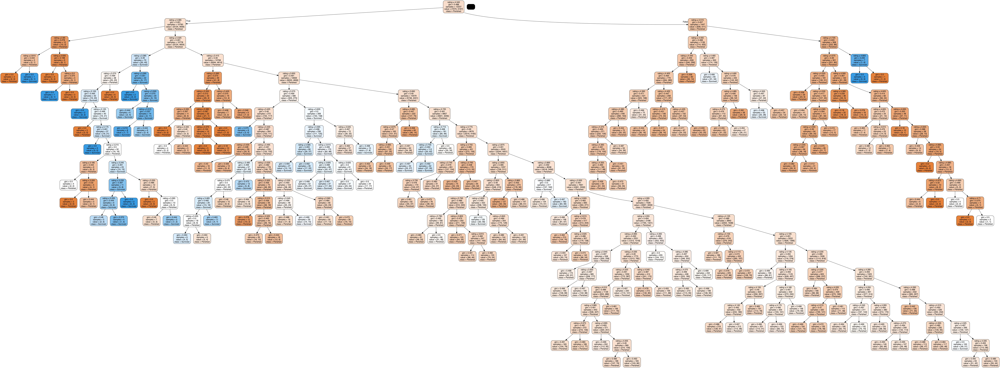

In [52]:
decisionTree = tree.DecisionTreeClassifier()

features = [
        "rating"
]

XTrain, XTest, yTrain, yTest = splitData(preprocessed_books, features, ["has_awards"])
# fit the tree with the traing data
decisionTree = decisionTree.fit(XTrain, yTrain)

# predict with the training data
y_pred_train = decisionTree.predict(XTrain)
# measure accuracy
print('Accuracy on training data = ', 
      metrics.accuracy_score(y_true = yTrain, y_pred = y_pred_train))

# predict with the test data
y_pred = decisionTree.predict(XTest)
# measure accuracy
print('Accuracy on test data = ', 
      metrics.accuracy_score(y_true = yTest, y_pred = y_pred))

renderTree(decisionTree, features)

<h3>Seems like rating is not enough, as suspected</h3>
<p>in the next section, we are going to improve our prediction using both, more features and improved params.</p>

In [53]:
decisionTree = tree.DecisionTreeClassifier(max_depth=10, min_samples_split=25)

features = [
        "rating",
        "editions_count",
        "is_title_changed",
        "top_tagged_genre_1",
        "top_tagged_genre_2",
        "currently_reading_count",
        "to_read_count",
        "author_followers_count",
        "ratings_count",
        "author_books_count"
]

XTrain, XTest, yTrain, yTest = splitData(preprocessed_books, features, ["has_awards"])
# fit the tree with the traing data
decisionTree = decisionTree.fit(XTrain, yTrain)

# predict with the training data
y_pred_train = decisionTree.predict(XTrain)
# measure accuracy
print('Accuracy on training data = ', 
      metrics.accuracy_score(y_true = yTrain, y_pred = y_pred_train))

# predict with the test data
y_pred = decisionTree.predict(XTest)
# measure accuracy
print('Accuracy on test data = ', 
      metrics.accuracy_score(y_true = yTest, y_pred = y_pred))

renderTree(decisionTree, features)

Accuracy on training data =  0.8300236986189425
Accuracy on test data =  0.7568031380240255
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.937915 to fit



<a id='ace'></a>
<h2>The ace in the sleeve</h2>
<h3>That's better but seems like maybe we can create a new column which may help us</h3>
<p>
    We are going to count how many books with awards the authors has and use it as an hint which may indicate for sucessful writing style.<br>
    The idea was to see if based on previous books the author was given awards the same author might get another award and that information will indicates a writing style that may be successful (As in other subjects such as movies where movies related to some directors are highly to be awarded). <br>
</p>

In [54]:
pre_df = preprocessed_books[preprocessed_books["has_awards"] == 1].groupby(by="author_name").sum()[["has_awards"]]
authors_has_awards_count = dict(zip(pre_df.index, pre_df["has_awards"].tolist()))
def get_author_awards_count(author_name, authors_has_awards_count):
    if author_name in authors_has_awards_count:
        return authors_has_awards_count[author_name]
    return 0
preprocessed_books["author_books_with_awards_count"] = preprocessed_books["author_name"].apply(lambda author_name: get_author_awards_count(author_name, authors_has_awards_count))

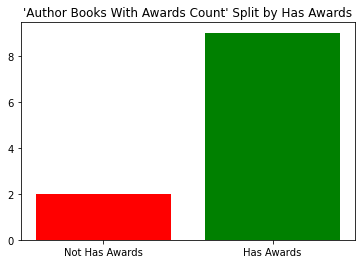

In [55]:
display_histogram_of_aggregative_metric_against_flag_column(
    preprocessed_books,
    "author_books_with_awards_count",
    "has_awards"
)

<p>
    Using the same aggregation graph we used before, You can now see that this "new" feature created by us has a lot of meaning to the prediction model.<br>
    Let's take a look at our new DataFrame. 
</p>    

In [56]:
preprocessed_books

,rating,ratings_count,reviews_count,book_format,pages_count,main_language,editions_count,has_awards,top_tagged_genre_1,top_tagged_genre_2,...,to_read_count,currently_reading_count,author_name,author_followers_count,author_books_count,author_avg_rating,author_ratings_count,author_reviews_count,is_title_changed,author_books_with_awards_count
0,4.48,81367.0,5393.0,10,309.0,3,74.0,1,26,53,...,67438.0,3968.0,2282,11934.0,221.0,4.46,694425.0,42326.0,1,15
1,4.43,81367.0,5393.0,10,341.0,3,74.0,1,26,53,...,67438.0,3968.0,2282,11934.0,221.0,4.46,694425.0,42326.0,0,15
2,4.58,81367.0,5393.0,16,435.0,3,74.0,1,26,156,...,67438.0,3968.0,2282,11934.0,221.0,4.46,694425.0,42326.0,0,15
3,4.28,81367.0,5393.0,18,366.0,3,50.0,1,26,27,...,67438.0,3968.0,2295,11934.0,146.0,4.35,694425.0,42326.0,0,15
4,4.57,81367.0,5393.0,18,421.0,3,74.0,1,26,156,...,67438.0,3968.0,2282,11934.0,221.0,4.46,694425.0,42326.0,0,15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
993,4.22,1259.0,35.0,18,120.0,3,2.0,0,29,35,...,1218.0,13.0,1336,7.0,11.0,4.18,1497.0,60.0,0,0
994,4.12,83.0,11.0,10,352.0,3,2.0,0,29,35,...,328.0,77.0,2172,0.0,1.0,4.12,83.0,11.0,0,0
996,3.91,291.0,46.0,11,327.0,3,3.0,0,29,35,...,267.0,322.0,250,453.0,199.0,4.19,54393.0,3005.0,0,2
998,4.16,194.0,31.0,11,400.0,3,3.0,0,29,35,...,294.0,137.0,4119,3.0,1.0,4.16,194.0,31.0,0,0


<p>
    Time to check if the new author awards count we added is helping us with prediction or not.
</p> 

Accuracy on training data =  0.8747241971071341
Accuracy on test data =  0.8529051238048542


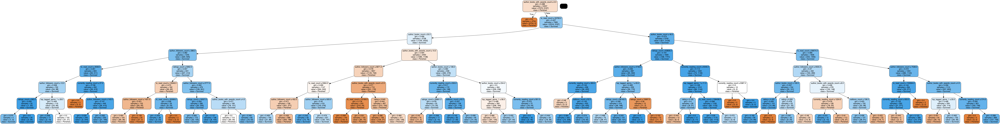

In [57]:
decisionTree = tree.DecisionTreeClassifier(max_depth=7, min_samples_split=10)

features = [
        "rating",
        "editions_count",
        "is_title_changed",
        "top_tagged_genre_1",
        "currently_reading_count",
        "to_read_count",
        "author_followers_count",
        "ratings_count",
        "author_books_count",
        "author_books_with_awards_count"
]

XTrain, XTest, yTrain, yTest = splitData(preprocessed_books, features, ["has_awards"])
# fit the tree with the traing data
decisionTree = decisionTree.fit(XTrain, yTrain)

# predict with the training data
y_pred_train = decisionTree.predict(XTrain)
# measure accuracy
print('Accuracy on training data = ', 
      metrics.accuracy_score(y_true = yTrain, y_pred = y_pred_train))

# predict with the test data
y_pred = decisionTree.predict(XTest)
# measure accuracy
print('Accuracy on test data = ', 
      metrics.accuracy_score(y_true = yTest, y_pred = y_pred))

renderTree(decisionTree, features)

<h3>Great improvement</h3>
<p>
    Our "Ace" did help with improving the test group prediction accuracy by 10%, which is highly significant.
</p>    

<a id='depth_opt'></a>
<h3>Depth optimization</h3>
<p>
    Using Grid Search we wanted to know if we can further improve our prediction accuracy.<br>
    The tests were done by using GridSearchVC from the selection module of sklrean.<br>
    The results were:
</p>    

In [58]:
parameters = {'max_depth': range(2, 12), "min_samples_split": range(5, 50) }
dt = tree.DecisionTreeClassifier()

clf = GridSearchCV(dt, parameters, scoring=make_scorer(metrics.accuracy_score, greater_is_better=True))
clf.fit(XTrain, yTrain)

print("best parameter set is:",clf.best_params_," and its score was",clf.best_score_)


best parameter set is: {'max_depth': 11, 'min_samples_split': 5}  and its score was 0.8657341856508302


<strong>Note that we decided to move in the range of 2-12 depths and split range of 5-50 in the samples split due to optionality to have overfitting if we try any higher values.</strong>

<p>Let's try to predict with the suggested max_depth</p>

Accuracy on training data =  0.9079839830023698
Accuracy on test data =  0.8673694532973768


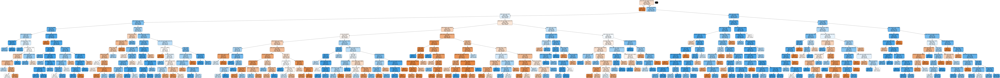

In [59]:
decisionTree = tree.DecisionTreeClassifier(max_depth=11, min_samples_split=30)

features = [
        "rating",
        "editions_count",
        "is_title_changed",
        "top_tagged_genre_1",
        "currently_reading_count",
        "to_read_count",
        "author_followers_count",
        "ratings_count",
        "author_books_count",
        "author_books_with_awards_count"
]

XTrain, XTest, yTrain, yTest = splitData(preprocessed_books, features, ["has_awards"])
# fit the tree with the traing data
decisionTree = decisionTree.fit(XTrain, yTrain)

# predict with the training data
y_pred_train = decisionTree.predict(XTrain)
# measure accuracy
print('Accuracy on training data = ', 
      metrics.accuracy_score(y_true = yTrain, y_pred = y_pred_train))

# predict with the test data
y_pred = decisionTree.predict(XTest)
# measure accuracy
print('Accuracy on test data = ', 
      metrics.accuracy_score(y_true = yTest, y_pred = y_pred))

renderTree(decisionTree, features)

<h3>Slight improvement</h3>
<p>
    We got ourselves a better training accuracy but the test prediction did not improve by a noticiable percentage.<br>
</p>    

<a id='random_forest'></a>
<h2>Prediction model - Random forest of decision trees</h2>
<p>
    Understanding that one tree was just not enough in order to predict if a book will get an award,<br>
    We decided to get better prediction results using random forest model.<br>
    Reasons to use this model:<br>
    <ul>
        <li>Bootstraping - Creating several different subtrees which the commoest of them all is decided as the best prediction using wisdom of the crowd.</li>
        <li>Different subgroups - allows us to try out bigger uncorrelated (by features) decision trees, thus we prevent trying to predict with the same trees multiple times.</li>
        <li>Combining bootsraping and different subgroups also performs as cross-validation which improve accuracy.</li>
    </ul>
</p>

In [61]:
features = [
        "rating",
        "editions_count",
        "is_title_changed",
        "top_tagged_genre_1",
        "currently_reading_count",
        "to_read_count",
        "author_followers_count",
        "ratings_count",
        "author_books_count",
        "author_books_with_awards_count"
]

XTrain, XTest, yTrain, yTest = splitData(preprocessed_books, features, ["has_awards"])

forest =  RandomForestClassifier(bootstrap=True, n_estimators=50, random_state=0)

trained_forest = forest.fit(XTrain, yTrain.ravel()) 

y_pred_train = trained_forest.predict(XTrain)
print('Accuracy on training data= ', metrics.accuracy_score(y_true = yTrain, y_pred = y_pred_train))

y_pred = trained_forest.predict(XTest)
print('Accuracy on test data= ', metrics.accuracy_score(y_true = yTest, y_pred = y_pred))


Accuracy on training data=  1.0
Accuracy on test data=  0.9166462368227507


<a id='overfitting'></a>
<h3> 100% of training accuracy, are we overfitting our model?</h3>
<p>
    At this point we were afraid our model is overfitting and that our training methodology needs to be changed.<br>
    So we went on investigation to understand, is the model overfitted?<br>
    After some investigation we found out we did not necessarily overfitted our model.<br>
    <a href="https://towardsdatascience.com/one-common-misconception-about-random-forest-and-overfitting-47cae2e2c23b">
        Here </a>
    is where we got the information which later on allowed us to understand we are not overfitting.
</p>    

<a id='improve_model'></a>
<h3>But can further improve the model?</h3>
<p>
    In order to answer that question we decide to "eliminate" the features which are the least efficient in the prediction.<br>
    So we gathered the weights of each feature in the prediction.
</p>    

In [62]:
featuresDF = pd.DataFrame({"features": features, "weights": trained_forest.feature_importances_})
featuresDF.sort_values("weights", ascending=False)

,features,weights
9,author_books_with_awards_count,0.392965
5,to_read_count,0.138544
7,ratings_count,0.097785
6,author_followers_count,0.075288
4,currently_reading_count,0.073873
8,author_books_count,0.065379
0,rating,0.053732
1,editions_count,0.052118
3,top_tagged_genre_1,0.042257
2,is_title_changed,0.008058


<p>
    The result is that <strong>is_title_changed</strong> was actually the least effective feature.<br>
    Let's remove the least affective feature (is_title_changed)
</p>

In [63]:
features = [
        "rating",
        "editions_count",
        "top_tagged_genre_1",
        "currently_reading_count",
        "to_read_count",
        "author_followers_count",
        "ratings_count",
        "author_books_count",
        "author_books_with_awards_count"
]

XTrain, XTest, yTrain, yTest = splitData(preprocessed_books, features, ["has_awards"])

forest =  RandomForestClassifier(bootstrap=True, n_estimators=50, random_state=0)

trained_forest = forest.fit(XTrain, yTrain.ravel()) 

y_pred_train = trained_forest.predict(XTrain)
print('Accuracy on training data= ', metrics.accuracy_score(y_true = yTrain, y_pred = y_pred_train))

y_pred = trained_forest.predict(XTest)
print('Accuracy on test data= ', metrics.accuracy_score(y_true = yTest, y_pred = y_pred))


Accuracy on training data=  1.0
Accuracy on test data=  0.9225300318705565


<a id='another_ace'></a>
<h3>Less is more?</h3>
<p>
    Removing the <strong>is_title_changed</strong> came up as a great idea which led to better accuracy.<br>
    But we still want to improve the model.<br>
    We can improve it a bit by understand the satisfaction of people by how many already left comment to how many read it and multiply them by author average ratio.<br>
    Let's create another "Ace"  of our own.
</p>

In [64]:
preprocessed_books["rating_in_comparison_to_author_avg"] = preprocessed_books["rating"] * preprocessed_books["author_avg_rating"]
preprocessed_books["left_reviews_to_reading_ratio_to_rating_synergy"] = preprocessed_books["rating_in_comparison_to_author_avg"] * ((preprocessed_books["reviews_count"] + preprocessed_books["ratings_count"]) / (preprocessed_books["currently_reading_count"] + preprocessed_books["to_read_count"]))


In [65]:
features = [
        "rating",
        "top_tagged_genre_1",
        "currently_reading_count",
        "to_read_count",
        "author_followers_count",
        "ratings_count",
        "author_books_count",
        "author_books_with_awards_count",
        "left_reviews_to_reading_ratio_to_rating_synergy"
]

XTrain, XTest, yTrain, yTest = splitData(preprocessed_books, features, ["has_awards"])

forest =  RandomForestClassifier(bootstrap=True, n_estimators=50, random_state=0)

trained_forest = forest.fit(XTrain, yTrain.ravel()) 

y_pred_train = trained_forest.predict(XTrain)
print('Accuracy on training data= ', metrics.accuracy_score(y_true = yTrain, y_pred = y_pred_train))

y_pred = trained_forest.predict(XTest)
print('Accuracy on test data= ', metrics.accuracy_score(y_true = yTest, y_pred = y_pred))


Accuracy on training data=  1.0
Accuracy on test data=  0.924000980632508


<h3>We were right</h3>
<p>
    We can use community satisfaction to our advantage, guess that the community has a part in awards giving decisions.<br>
    But was this new "Ace" an important part of the equation of the prediction?<br>
    Let's check the new feature's weight.
</p>    

In [66]:
featuresDF = pd.DataFrame({"features": features, "weights": trained_forest.feature_importances_})
featuresDF.sort_values("weights", ascending=False)

,features,weights
7,author_books_with_awards_count,0.390284
3,to_read_count,0.142737
5,ratings_count,0.096590
4,author_followers_count,0.076095
2,currently_reading_count,0.069476
6,author_books_count,0.065218
8,left_reviews_to_reading_ratio_to_rating_synergy,0.063305
0,rating,0.052827
1,top_tagged_genre_1,0.043468


<a id='grid_search_forest'></a>
<p>
    The new feature has higher weight in the equation than 2 other features, which means our feature can be acceptable in our prediction model.
</p>    
<h3>Did we finally get the best results we could?</h3>
<p>
    In order to check that we went on and created another test over random forest and many configurations to see which configuration will get the best results.<br>
    The configuration options were as list:
    <ul>
        <li>Bootsrap - always on so we will use just a sample of the dataset and not the whole dataset to build the trees.</li>
        <li>n_estimators - The amount of estimators, we were wondering if more trees will get better results.</li>
        <li>random_state - was set to 0 to make sure the dataset used in every tree is the same.</li>
        <li>max_features - we tried to check all built in options the forest tree classifier has to find the best amount of features. </li>
     </ul>
</p>

In [67]:
# some hyper-params tuning
parameters = {
    'bootstrap':[True],
    'n_estimators':[50, 51, 53, 100, 101, 501, 1000],
    'random_state':[0],
    'max_features':['sqrt', 'log2', 'auto']
}
rf = RandomForestClassifier()
clf = GridSearchCV(rf, parameters, scoring=make_scorer(metrics.accuracy_score, greater_is_better=True))
clf.fit(XTrain, yTrain.ravel())
print("best parameter set is:",clf.best_params_," and its score was",clf.best_score_)

best parameter set is: {'bootstrap': True, 'max_features': 'sqrt', 'n_estimators': 1000, 'random_state': 0}  and its score was 0.9171361624611702


<a id='the_top'></a>
<h3>Reached the top?</h3>
<p>
    So now we know the features combination that gives the best prediction but were we just lucky in the train/test split selection? or our model actually works?<br>
    In order to assure our model works we decided to do the followings:<br>
    <ol>
        <li>F-score - To determine the test's accuracy.</li>
        <li>Testing if there is another dataset randomness which will get similar results.</li>
    </ol>
</p>    
<h3>Prooving our test results are valid by adding the f-score results of our tests</h3>

In [68]:
features = [
        "rating",
        "top_tagged_genre_1",
        "currently_reading_count",
        "to_read_count",
        "author_followers_count",
        "ratings_count",
        "author_books_count",
        "author_books_with_awards_count",
        "left_reviews_to_reading_ratio_to_rating_synergy"
]

XTrain, XTest, yTrain, yTest = splitData(preprocessed_books, features, ["has_awards"])

forest =  RandomForestClassifier(bootstrap=True, n_estimators=53, random_state=0, max_features='sqrt')

trained_forest = forest.fit(XTrain, yTrain.ravel()) 

y_pred_train = trained_forest.predict(XTrain)
print('Accuracy on training data= ', metrics.accuracy_score(y_true = yTrain, y_pred = y_pred_train))

y_pred = trained_forest.predict(XTest)
print('Accuracy on test data= ', metrics.accuracy_score(y_true = yTest, y_pred = y_pred))

print('f_measure score= ',  f1_score(yTest, y_pred))


Accuracy on training data=  1.0
Accuracy on test data=  0.926697720029419
f_measure score=  0.9179698216735255


<a id='random_states'></a>
<h3>Checking list of random states of datasets</h3>

In [69]:
# let's test it on some more splits (some self cross validation)
def manual_different_test_groups_accuracy_calc(split_random_state: int):
    features = [
            "rating",
            "top_tagged_genre_1",
            "currently_reading_count",
            "to_read_count",
            "author_followers_count",
            "ratings_count",
            "author_books_count",
            "author_books_with_awards_count",
            "left_reviews_to_reading_ratio_to_rating_synergy"
    ]

    XTrain, XTest, yTrain, yTest = splitData(preprocessed_books, features, ["has_awards"], split_random_state)

    forest =  RandomForestClassifier(bootstrap=True, n_estimators=53, random_state=0, max_features='sqrt')

    trained_forest = forest.fit(XTrain, yTrain.ravel()) 

    y_pred_train = trained_forest.predict(XTrain)
    print('Accuracy on training data= ', metrics.accuracy_score(y_true = yTrain, y_pred = y_pred_train))

    y_pred = trained_forest.predict(XTest)
    print('Accuracy on test data= ', metrics.accuracy_score(y_true = yTest, y_pred = y_pred))

    print('f_measure score= ',  f1_score(yTest, y_pred))

    
split_random_states = [0, 42, 100, 53, 51, 177, 9, 10, 11, 12, 13, 19, 48, 90, 101, 57, 88, 99, 20, 900, 40, 28, 19, 90]

for random_state in split_random_states:
    print("--------")
    print("random_state= ", random_state)
    manual_different_test_groups_accuracy_calc(random_state)
    print("--------")



--------
random_state=  0
Accuracy on training data=  0.9999182806243361
Accuracy on test data=  0.9242461387594999
f_measure score=  0.9122408406702641
--------
--------
random_state=  42
Accuracy on training data=  1.0
Accuracy on test data=  0.926697720029419
f_measure score=  0.9179698216735255
--------
--------
random_state=  100
Accuracy on training data=  0.9999182806243361
Accuracy on test data=  0.9193429762196617
f_measure score=  0.9082798996375802
--------
--------
random_state=  53
Accuracy on training data=  0.999836561248672
Accuracy on test data=  0.9205687668546212
f_measure score=  0.9086294416243654
--------
--------
random_state=  51
Accuracy on training data=  0.9999182806243361
Accuracy on test data=  0.9200784506006374
f_measure score=  0.9096452328159644
--------
--------
random_state=  177
Accuracy on training data=  0.9999182806243361
Accuracy on test data=  0.9088011767590095
f_measure score=  0.897914379802415
--------
--------
random_state=  9
Accuracy on t

<a id='conclusion'></a>
<h2>Conclusion</h2>
<p>
    Predicting if a book will get an awards comes with the need of familiarity with the dataset (i.e : knowing who the author is  may help with distinguish between legit record to an outlier and trigger appropriate action) and creativity to use existing data to create new features which can be used to improve the model prediction accuracy (i.e: using the knowledge of the author to create new dimension of data related to the amount of awards the author gathered).<br> 
    However, after observing the results of so many predictions (decision trees) we think that our model can predict with high accuracy.
</p>  

<strong>Credits:</strong><br>
some of the used functions were taken from Campus IL course (Intro for Data Science):<br>
i.e:<br>
<u>
<li>visualizing the decision tree</li>
<li>detecting outliers using basic IQR</li>
<li>detecting outliers using z score</li>
</u>
Many thanks for sharing the knowledge.